In [1]:
## Import Packages
from __future__ import print_function

import numpy as np
import pandas as pd
from itertools import product

#Astro Software
import astropy.units as units
from astropy.coordinates import SkyCoord
from astropy.io import fits

#Plotting Packages
import matplotlib as mpl
import matplotlib.cm as cm
import matplotlib.pyplot as plt
from matplotlib import rcParams

import seaborn as sns

from PIL import Image

from yt.config import ytcfg
import yt
import yt.units as u

#Scattering NN
import torch
import torch.nn.functional as F
from torch import optim
from kymatio.torch import Scattering2D
device = "cpu"

#Machine Learning
from sklearn.model_selection import train_test_split
from sklearn.mixture import GaussianMixture
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.decomposition import PCA, FastICA

import skimage
from skimage import filters

from scipy.optimize import curve_fit
from scipy import linalg
from scipy import stats
from scipy.signal import general_gaussian

#I/O
import h5py
import pickle
import glob
import copy
import time

#Plotting Style
%matplotlib inline
plt.style.use('dark_background')
rcParams['text.usetex'] = False
rcParams['axes.titlesize'] = 20
rcParams['xtick.labelsize'] = 16
rcParams['ytick.labelsize'] = 16
rcParams['legend.fontsize'] = 12
rcParams['axes.labelsize'] = 20
rcParams['font.family'] = 'sans-serif'

#Threading
torch.set_num_threads=2
from multiprocessing import Pool

import ntpath
def path_leaf(path):
    head, tail = ntpath.split(path)
    out = os.path.splitext(tail)[0]
    return out

def hd5_open(file_name,name):
    f=h5py.File(file_name,'r', swmr=True)
    data = f[name][:]
    f.close()
    return data

from matplotlib.colors import LinearSegmentedColormap
cdict1 = {'red':   ((0.0, 0.0, 0.0),
                   (0.5, 0.0, 0.0),
                   (1.0, 1.0, 1.0)),

         'green': ((0.0, 0.0, 0.0),
                   (1.0, 0.0, 0.0)),

         'blue':  ((0.0, 0.0, 1.0),
                   (0.5, 0.0, 0.0),
                   (1.0, 0.0, 0.0))
        }
blue_red1 = LinearSegmentedColormap('BlueRed1', cdict1,N=5000)

from sklearn.preprocessing import StandardScaler

/opt/miniconda3/envs/IWST/lib/python3.8/_collections_abc.py:666: MatplotlibDeprecationWarning: The global colormaps dictionary is no longer considered public API.
  self[key]


To Do:
- linear equivariance (*)
- L-depend train size tests (*)
- chi-square (*)
- explore important coeff
    - remove corner js to see if 4 spikes disapear
    - J dependent L
- multimodality application
- no combing curve attribution (angio gram) [filament/curve detector paper]
- compute
    - Cosmology
- PR
    - imrotate

WU:
- WSTkymatio on MNIST
- half dyadic j (test)
- rotMNIST
- parallel dropout
- WISE (clustering)

In [2]:
def DHC_iso_vec(wst,J,L):
    (nk, Nd) = np.shape(wst)
    S0 = wst[:,0:2]
    S1 = wst[:,2:J*L+2]
    S2 = np.reshape(wst[:,J*L+3:],(nk,(J*L+1),(J*L+1)))
    
    S1iso = np.zeros((nk,J))
    for j1 in range(J):
        for l1 in range(L):
            S1iso[:,j1] += S1[:,l1*J+j1]
    
    S2iso = np.zeros((nk,J,J,L))
    for j1 in range(J):
        for j2 in range(J):
            for l1 in range(L):
                for l2 in range(L):
                    deltaL = np.mod(l1-l2,L)
                    S2iso[:,j1,j2,deltaL] += S2[:,l1*J+j1,l2*J+j2]
                    
    Sphi1 = np.zeros((nk,J))
    for j1 in range(J):
        for l1 in range(L):
            Sphi1[:,j1] += S2[:,l1*J+j1,L*J]
            
    Sphi2 = np.zeros((nk,J))
    for j1 in range(J):
        for l1 in range(L):
            Sphi2[:,j1] += S2[:,L*J,l1*J+j1]
            
    return np.hstack((S0,S1iso,wst[:,J*L+2].reshape(nk,1),S2iso.reshape(nk,J*J*L),Sphi1,Sphi2,S2[:,L*J,L*J].reshape(nk,1)))

In [3]:
mnist_DHC_out_sizetrain = hd5_open('../../DHC/scratch_AKS/mnist_DHC_out_rot7pi_8.h5','main/data')
mnist_DHC_out_sizetest = hd5_open('../../DHC/scratch_AKS/mnist_DHC_out_rot7pi_8_test.h5','main/data')
mnist_DHC_out_sizetest_iso = DHC_iso_vec(mnist_DHC_out_sizetest,6,8)
mnist_DHC_out_sizetrain_iso = DHC_iso_vec(mnist_DHC_out_sizetrain,6,8)

In [3]:
mnist_train_y = hd5_open('../../DHC/scratch_AKS/mnist_train_y.h5','main/data')
mnist_test_y = hd5_open('../../DHC/scratch_AKS/mnist_test_y.h5','main/data')

In [3]:
import umap

In [4]:
import numpy as np
from sklearn.datasets import load_digits
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
%matplotlib inline

In [8]:
digits = load_digits()

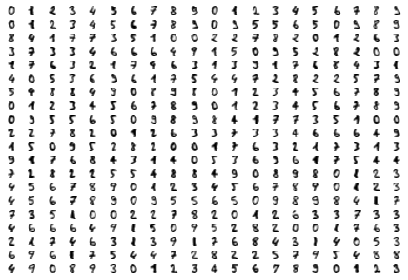

In [9]:
fig, ax_array = plt.subplots(20, 20)
axes = ax_array.flatten()
for i, ax in enumerate(axes):
    ax.imshow(digits.images[i], cmap='gray_r')
plt.setp(axes, xticks=[], yticks=[], frame_on=False)
plt.tight_layout(h_pad=0.5, w_pad=0.01)

In [15]:
reducer = umap.UMAP(random_state=42)
reducer.fit(digits.data)

UMAP(dens_frac=0.0, dens_lambda=0.0, random_state=42)

In [26]:
digits.data.shape

(1797, 64)

In [16]:
embedding = reducer.transform(digits.data)
# Verify that the result of calling transform is
# idenitical to accessing the embedding_ attribute
assert(np.all(embedding == reducer.embedding_))
embedding.shape

(1797, 2)

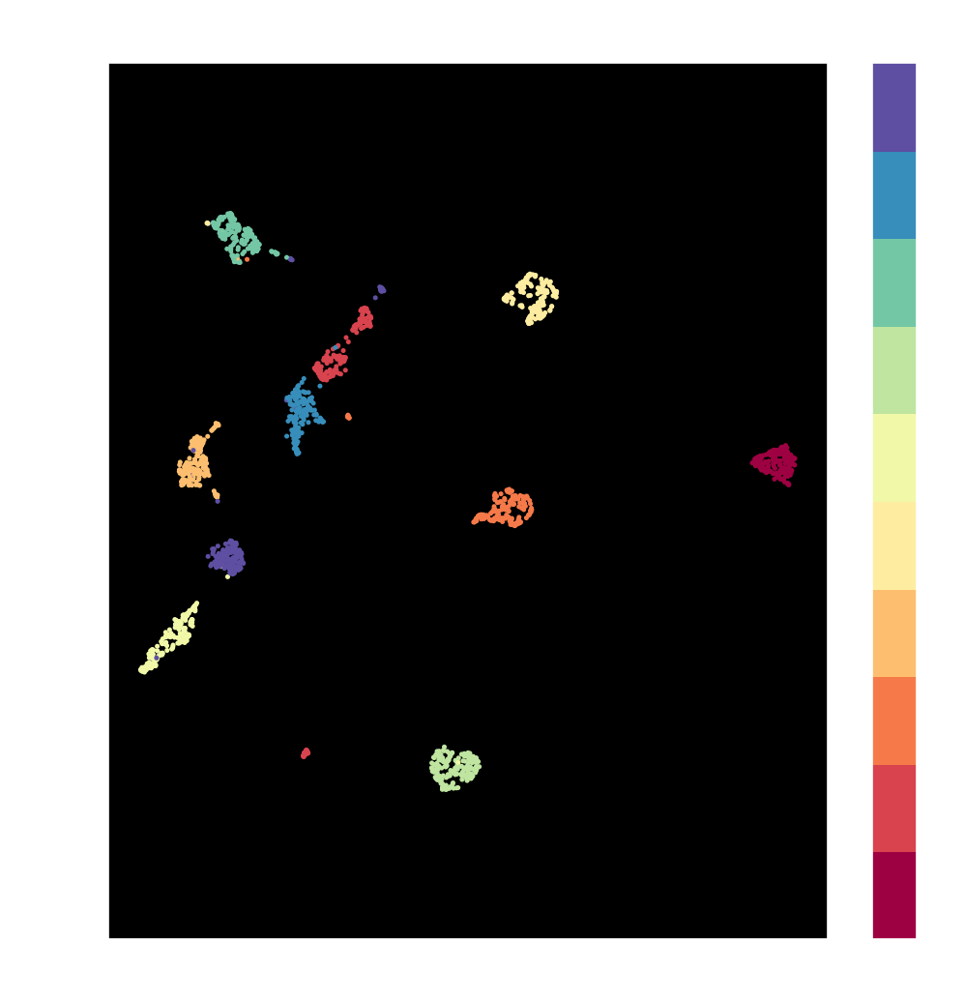

In [17]:
fig = plt.figure(figsize=(8,8),dpi=150)
plt.scatter(embedding[:, 0], embedding[:, 1], c=digits.target, cmap='Spectral', s=2)
plt.gca().set_aspect('equal', 'datalim')
plt.colorbar(boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
plt.title('UMAP projection of the Digits dataset', fontsize=24);

In [18]:
from io import BytesIO
from PIL import Image
import base64

In [19]:
def embeddable_image(data):
    img_data = 255 - 15 * data.astype(np.uint8)
    image = Image.fromarray(img_data, mode='L').resize((64, 64), Image.BICUBIC)
    buffer = BytesIO()
    image.save(buffer, format='png')
    for_encoding = buffer.getvalue()
    return 'data:image/png;base64,' + base64.b64encode(for_encoding).decode()

In [21]:
from bokeh.plotting import figure, show, output_notebook
from bokeh.models import HoverTool, ColumnDataSource, CategoricalColorMapper
from bokeh.palettes import Spectral10

output_notebook()

Loading BokehJS ...

In [105]:
from bokeh.themes import built_in_themes
from bokeh.io import curdoc

In [25]:
digits_df = pd.DataFrame(embedding, columns=('x', 'y'))
digits_df['digit'] = [str(x) for x in digits.target]
digits_df['image'] = list(map(embeddable_image, digits.images))

datasource = ColumnDataSource(digits_df)
curdoc().theme = 'dark_minimal'
color_mapping = CategoricalColorMapper(factors=[str(9 - x) for x in digits.target_names],
                                       palette=Spectral10)

plot_figure = figure(
    title='UMAP projection of the Digits dataset',
    plot_width=600,
    plot_height=600,
    tools=('pan, wheel_zoom, reset')
)

plot_figure.add_tools(HoverTool(tooltips="""
<div>
    <div>
        <img src='@image' style='float: left; margin: 5px 5px 5px 5px'/>
    </div>
    <div>
        <span style='font-size: 16px; color: #224499'>Digit:</span>
        <span style='font-size: 18px'>@digit</span>
    </div>
</div>
"""))

plot_figure.circle(
    'x',
    'y',
    source=datasource,
    color=dict(field='digit', transform=color_mapping),
    line_alpha=0.6,
    fill_alpha=0.6,
    size=4
)
show(plot_figure)

Let me try our coeff for MNIST

In [27]:
reducer = umap.UMAP(random_state=42)
reducer.fit(mnist_DHC_out_sizetrain)

UMAP(dens_frac=0.0, dens_lambda=0.0, random_state=42)

In [28]:
embedding = reducer.embedding_

In [29]:
embedding.shape

(60000, 2)

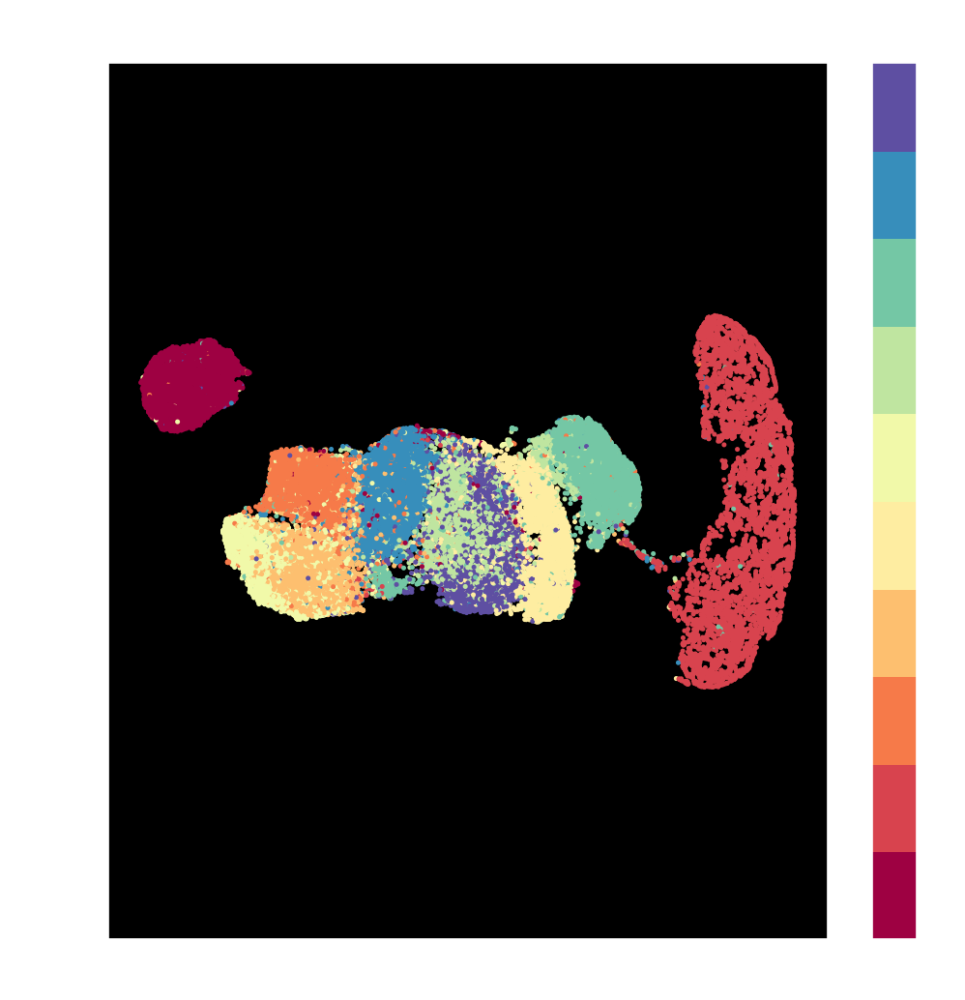

In [31]:
fig = plt.figure(figsize=(8,8),dpi=150)
plt.scatter(embedding[:, 0], embedding[:, 1], c=mnist_train_y, cmap='Spectral', s=2)
plt.gca().set_aspect('equal', 'datalim')
plt.colorbar(boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
plt.title('UMAP projection of the Digits dataset', fontsize=24);

In [32]:
test_embed = reducer.transform(mnist_DHC_out_sizetest)

inside function
   (0, 4130)	0.22648382
  (0, 9001)	0.33452252
  (0, 13637)	0.28664684
  (0, 14563)	0.22302017
  (0, 20380)	0.26294768
  (0, 21217)	0.37656164
  (0, 24572)	0.26692712
  (0, 26287)	0.28573033
  (0, 41660)	0.22158076
  (0, 45374)	0.24743018
  (0, 47003)	0.2928045
  (0, 48955)	0.3066842
  (0, 49071)	0.31281742
  (0, 53843)	0.46946302
  (0, 58733)	0.26272637
  (1, 8390)	0.25367332
  (1, 12916)	0.2712255
  (1, 15368)	0.26278538
  (1, 23468)	0.26285192
  (1, 24612)	0.2623523
  (1, 25564)	0.29983994
  (1, 26357)	0.2591387
  (1, 31956)	0.33179635
  (1, 32973)	0.2603825
  (1, 32981)	0.37546682
  :	:
  (9998, 5991)	0.28174517
  (9998, 10811)	0.24624781
  (9998, 11055)	0.2722846
  (9998, 11198)	0.26152465
  (9998, 29189)	0.25209862
  (9998, 29359)	0.26084864
  (9998, 31979)	0.29029813
  (9998, 36683)	0.32852545
  (9998, 46941)	0.3676333
  (9998, 54673)	0.27005285
  (9999, 2523)	0.22012822
  (9999, 5071)	0.3040833
  (9999, 5179)	0.2985425
  (9999, 5273)	0.23875798
  (9999, 7641)	0.

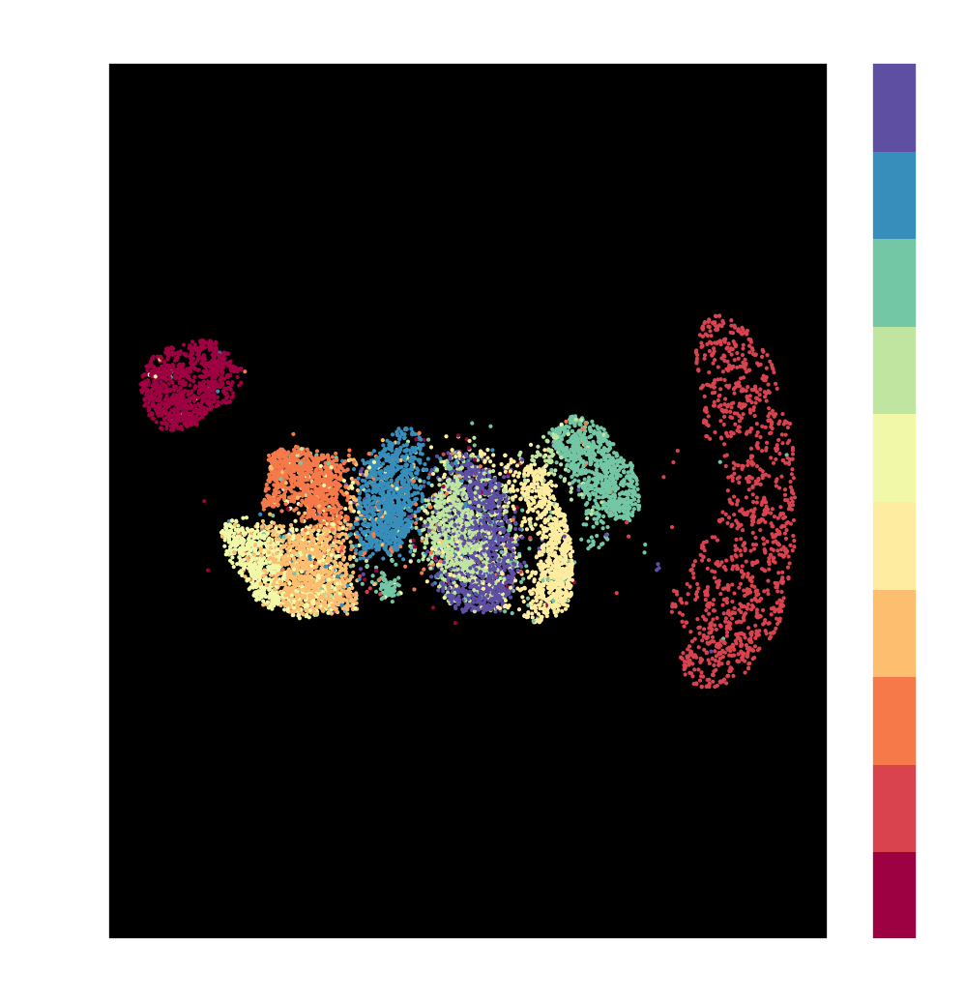

In [34]:
fig = plt.figure(figsize=(8,8),dpi=150)
plt.scatter(test_embed[:, 0], test_embed[:, 1], c=mnist_test_y, cmap='Spectral', s=1)
plt.gca().set_aspect('equal', 'datalim')
plt.colorbar(boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
plt.title('UMAP projection of the Digits dataset', fontsize=24);

In [13]:
import umap.plot

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


<AxesSubplot:>

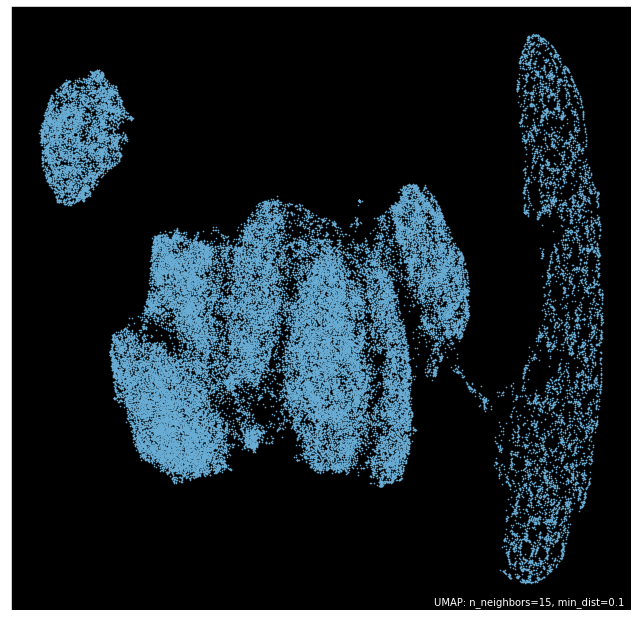

In [40]:
umap.plot.points(reducer,background='black')

<AxesSubplot:>

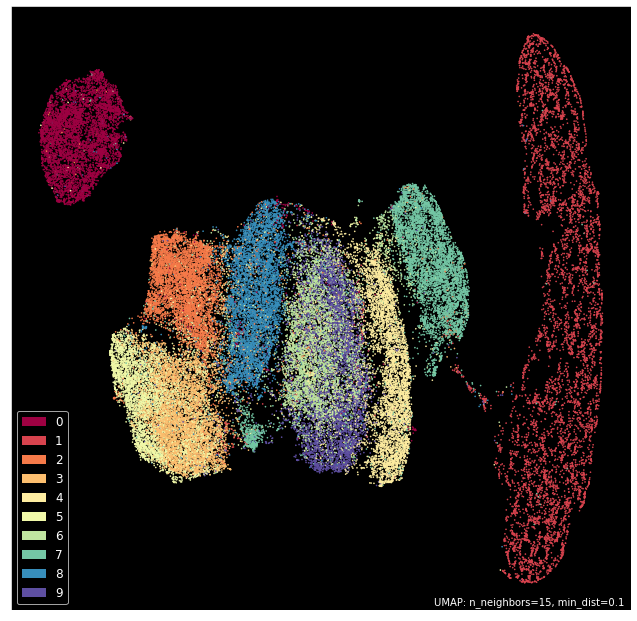

In [39]:
umap.plot.points(reducer,labels=mnist_train_y,background='black')

<AxesSubplot:>

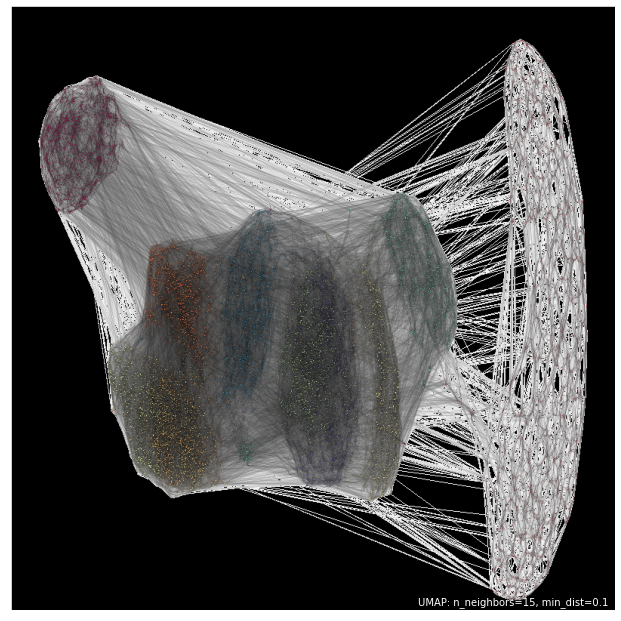

In [41]:
umap.plot.connectivity(reducer,labels=mnist_train_y,background='black', show_points=True)

/opt/miniconda3/envs/IWST/lib/python3.8/site-packages/umap/plot.py:853: UserWarning: Hammer edge bundling is expensive for large graphs!
This may take a long time to compute!
  warn(


<AxesSubplot:>

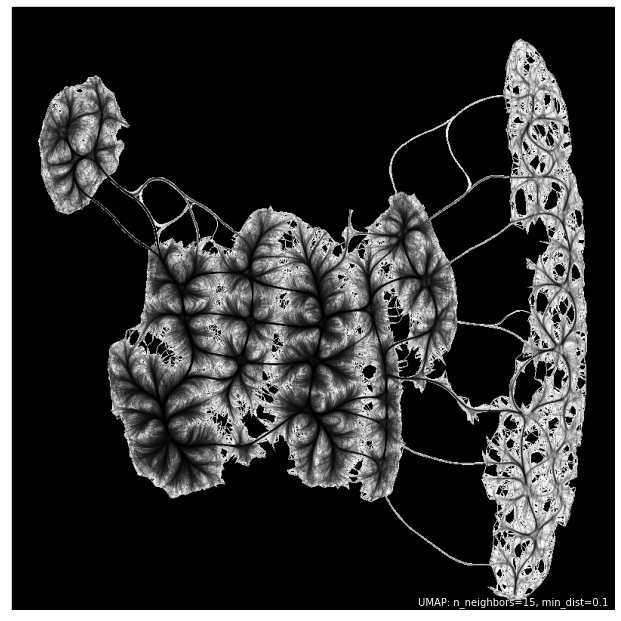

In [46]:
umap.plot.connectivity(reducer,labels=mnist_train_y,background='black', edge_bundling='hammer')

<AxesSubplot:title={'center':'Colored by RGB coords of PCA embedding'}>

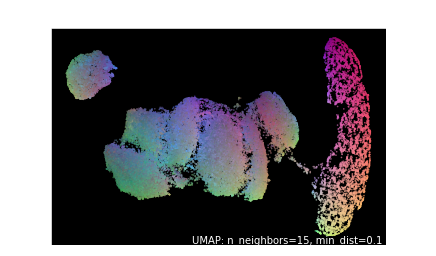

In [43]:
umap.plot.diagnostic(reducer, diagnostic_type='pca',background='black')

<AxesSubplot:title={'center':'Colored by RGB coords of Vector Quantization'}>

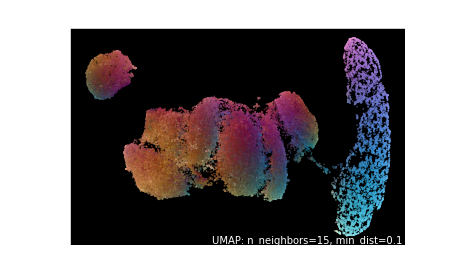

In [44]:
umap.plot.diagnostic(reducer, diagnostic_type='vq',background='black')

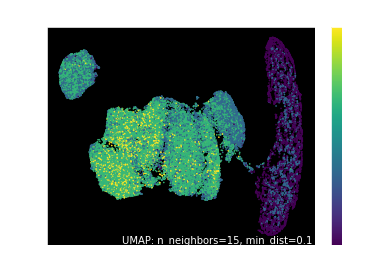

In [45]:
local_dims = umap.plot.diagnostic(reducer, diagnostic_type='local_dim',background='black')

/opt/miniconda3/envs/IWST/lib/python3.8/site-packages/umap/plot.py:201: NumbaWarning: 
Compilation is falling back to object mode WITH looplifting enabled because Function "_nhood_compare" failed type inference due to: Use of unsupported NumPy function 'numpy.intersect1d' or unsupported use of the function.

File "../../../../../../../../opt/miniconda3/envs/IWST/lib/python3.8/site-packages/umap/plot.py", line 207:
def _nhood_compare(indices_left, indices_right):
    <source elided>
    for i in range(indices_left.shape[0]):
        intersection_size = np.intersect1d(indices_left[i], indices_right[i]).shape[0]
        ^

During: typing of get attribute at /opt/miniconda3/envs/IWST/lib/python3.8/site-packages/umap/plot.py (207)

File "../../../../../../../../opt/miniconda3/envs/IWST/lib/python3.8/site-packages/umap/plot.py", line 207:
def _nhood_compare(indices_left, indices_right):
    <source elided>
    for i in range(indices_left.shape[0]):
        intersection_size = np.intersect1d(

<AxesSubplot:title={'center':'Colored by neighborhood Jaccard index'}>

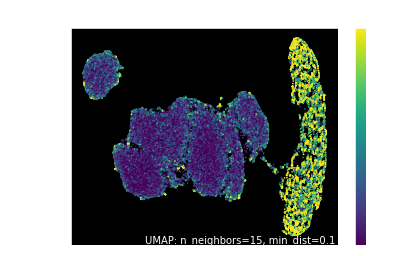

In [47]:
umap.plot.diagnostic(reducer, diagnostic_type='neighborhood',background='black')

In [50]:
%%time 
reducer = umap.UMAP(random_state=42)
reducer.fit(mnist_DHC_out_sizetrain_iso)

CPU times: user 4min 21s, sys: 7.96 s, total: 4min 29s
Wall time: 22.2 s


UMAP(dens_frac=0.0, dens_lambda=0.0)

In [51]:
lda = LDA(n_components=9)
X_train = lda.fit_transform(mnist_DHC_out_sizetrain, mnist_train_y)

In [52]:
%%time 
reducer = umap.UMAP(random_state=42)
reducer.fit(X_train)

CPU times: user 1min 33s, sys: 4.63 s, total: 1min 38s
Wall time: 38.5 s


UMAP(dens_frac=0.0, dens_lambda=0.0, random_state=42)

In [53]:
embedding = reducer.embedding_

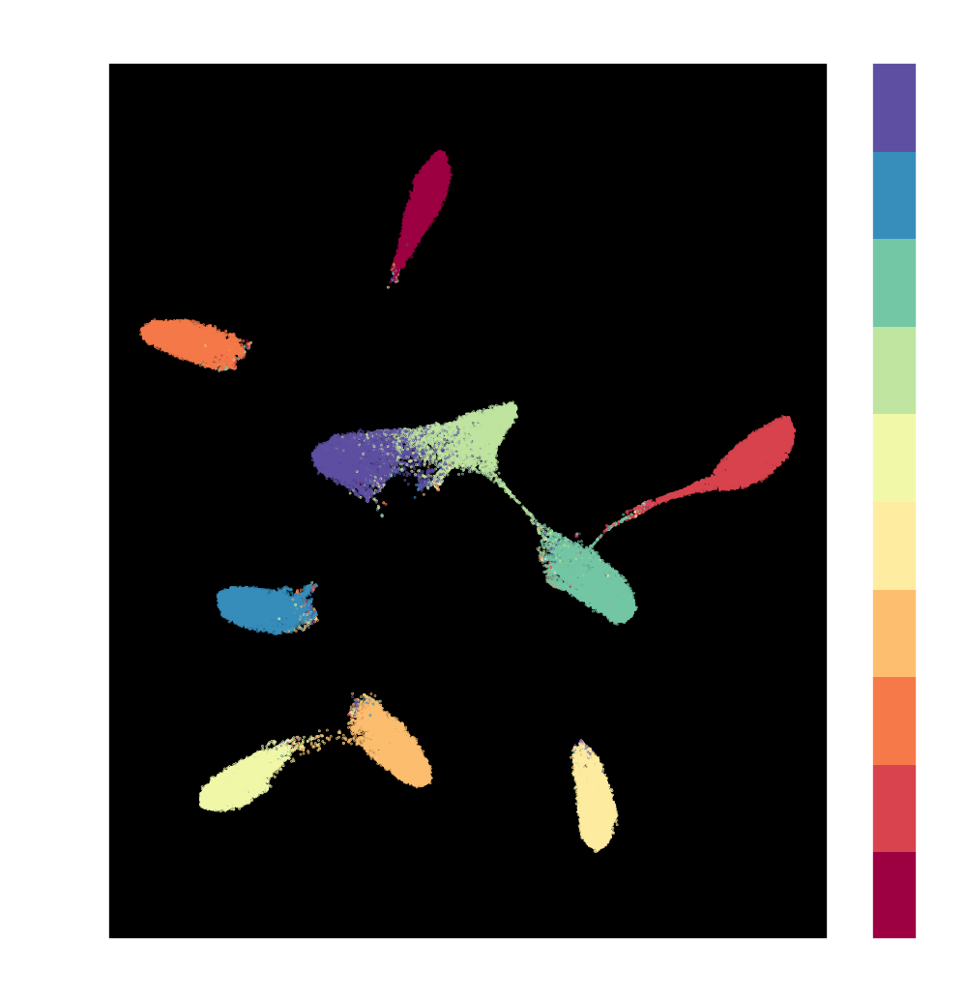

In [56]:
fig = plt.figure(figsize=(8,8),dpi=150)
plt.scatter(embedding[:, 0], embedding[:, 1], c=mnist_train_y, cmap='Spectral', s=0.1)
plt.gca().set_aspect('equal', 'datalim')
plt.colorbar(boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
plt.title('UMAP projection of the Digits dataset', fontsize=24);

<AxesSubplot:>

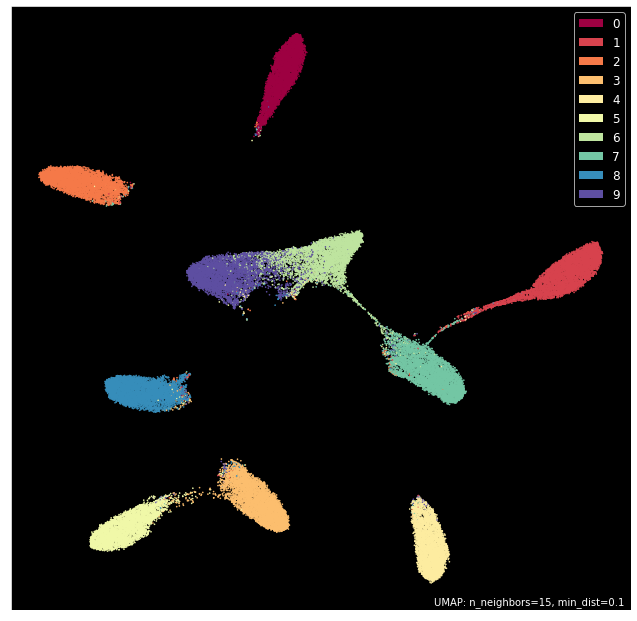

In [57]:
umap.plot.points(reducer,labels=mnist_train_y,background='black')

In [8]:
from umap.parametric_umap import ParametricUMAP
embedder = ParametricUMAP()

In [9]:
embedding = embedder.fit_transform(mnist_DHC_out_sizetrain)

Epoch 1/10
685/685 [==============================] - ETA: 13:56 - loss: 7.67 - ETA: 15s - loss: 7.4145 - ETA: 14s - loss: 7.11 - ETA: 13s - loss: 6.83 - ETA: 13s - loss: 6.57 - ETA: 13s - loss: 6.34 - ETA: 13s - loss: 6.12 - ETA: 13s - loss: 5.92 - ETA: 12s - loss: 5.73 - ETA: 12s - loss: 5.56 - ETA: 12s - loss: 5.40 - ETA: 12s - loss: 5.25 - ETA: 12s - loss: 5.10 - ETA: 12s - loss: 4.97 - ETA: 12s - loss: 4.85 - ETA: 12s - loss: 4.73 - ETA: 12s - loss: 4.62 - ETA: 12s - loss: 4.51 - ETA: 11s - loss: 4.41 - ETA: 11s - loss: 4.32 - ETA: 11s - loss: 4.23 - ETA: 11s - loss: 4.14 - ETA: 11s - loss: 4.06 - ETA: 11s - loss: 3.98 - ETA: 11s - loss: 3.91 - ETA: 11s - loss: 3.84 - ETA: 11s - loss: 3.77 - ETA: 11s - loss: 3.71 - ETA: 11s - loss: 3.64 - ETA: 11s - loss: 3.58 - ETA: 11s - loss: 3.53 - ETA: 11s - loss: 3.47 - ETA: 11s - loss: 3.42 - ETA: 11s - loss: 3.37 - ETA: 11s - loss: 3.32 - ETA: 10s - loss: 3.27 - ETA: 10s - loss: 3.22 - ETA: 10s - loss: 3.18 - ETA: 10s - loss: 3.14 - ETA: 1

685/685 [==============================] - ETA: 12s - loss: 0.18 - ETA: 17s - loss: 0.18 - ETA: 15s - loss: 0.18 - ETA: 15s - loss: 0.18 - ETA: 15s - loss: 0.18 - ETA: 14s - loss: 0.18 - ETA: 14s - loss: 0.18 - ETA: 14s - loss: 0.18 - ETA: 14s - loss: 0.18 - ETA: 14s - loss: 0.18 - ETA: 14s - loss: 0.18 - ETA: 14s - loss: 0.18 - ETA: 14s - loss: 0.18 - ETA: 14s - loss: 0.18 - ETA: 14s - loss: 0.18 - ETA: 14s - loss: 0.18 - ETA: 14s - loss: 0.18 - ETA: 14s - loss: 0.18 - ETA: 14s - loss: 0.18 - ETA: 14s - loss: 0.18 - ETA: 14s - loss: 0.18 - ETA: 14s - loss: 0.18 - ETA: 13s - loss: 0.18 - ETA: 13s - loss: 0.18 - ETA: 13s - loss: 0.18 - ETA: 13s - loss: 0.18 - ETA: 13s - loss: 0.18 - ETA: 13s - loss: 0.18 - ETA: 13s - loss: 0.18 - ETA: 13s - loss: 0.18 - ETA: 13s - loss: 0.18 - ETA: 13s - loss: 0.18 - ETA: 13s - loss: 0.18 - ETA: 13s - loss: 0.18 - ETA: 13s - loss: 0.18 - ETA: 13s - loss: 0.18 - ETA: 13s - loss: 0.18 - ETA: 13s - loss: 0.18 - ETA: 13s - loss: 0.18 - ETA: 12s - loss: 0.18

685/685 [==============================] - ETA: 9s - loss: 0.170 - ETA: 14s - loss: 0.17 - ETA: 14s - loss: 0.17 - ETA: 14s - loss: 0.17 - ETA: 14s - loss: 0.17 - ETA: 14s - loss: 0.17 - ETA: 14s - loss: 0.17 - ETA: 14s - loss: 0.17 - ETA: 14s - loss: 0.17 - ETA: 14s - loss: 0.17 - ETA: 14s - loss: 0.17 - ETA: 14s - loss: 0.17 - ETA: 14s - loss: 0.17 - ETA: 13s - loss: 0.17 - ETA: 13s - loss: 0.17 - ETA: 13s - loss: 0.17 - ETA: 13s - loss: 0.17 - ETA: 13s - loss: 0.17 - ETA: 13s - loss: 0.17 - ETA: 13s - loss: 0.17 - ETA: 13s - loss: 0.17 - ETA: 13s - loss: 0.17 - ETA: 13s - loss: 0.17 - ETA: 13s - loss: 0.17 - ETA: 13s - loss: 0.17 - ETA: 13s - loss: 0.17 - ETA: 12s - loss: 0.17 - ETA: 12s - loss: 0.17 - ETA: 12s - loss: 0.17 - ETA: 12s - loss: 0.17 - ETA: 12s - loss: 0.17 - ETA: 12s - loss: 0.17 - ETA: 12s - loss: 0.17 - ETA: 12s - loss: 0.17 - ETA: 12s - loss: 0.17 - ETA: 12s - loss: 0.17 - ETA: 12s - loss: 0.17 - ETA: 12s - loss: 0.17 - ETA: 12s - loss: 0.17 - ETA: 12s - loss: 0.17

685/685 [==============================] - ETA: 11s - loss: 0.17 - ETA: 15s - loss: 0.17 - ETA: 15s - loss: 0.17 - ETA: 15s - loss: 0.17 - ETA: 15s - loss: 0.17 - ETA: 16s - loss: 0.17 - ETA: 15s - loss: 0.17 - ETA: 15s - loss: 0.17 - ETA: 15s - loss: 0.17 - ETA: 15s - loss: 0.17 - ETA: 15s - loss: 0.17 - ETA: 15s - loss: 0.17 - ETA: 15s - loss: 0.17 - ETA: 15s - loss: 0.17 - ETA: 15s - loss: 0.17 - ETA: 14s - loss: 0.17 - ETA: 14s - loss: 0.17 - ETA: 14s - loss: 0.17 - ETA: 14s - loss: 0.17 - ETA: 14s - loss: 0.17 - ETA: 14s - loss: 0.17 - ETA: 14s - loss: 0.17 - ETA: 14s - loss: 0.17 - ETA: 14s - loss: 0.17 - ETA: 14s - loss: 0.17 - ETA: 14s - loss: 0.17 - ETA: 14s - loss: 0.17 - ETA: 14s - loss: 0.17 - ETA: 14s - loss: 0.17 - ETA: 14s - loss: 0.17 - ETA: 14s - loss: 0.17 - ETA: 14s - loss: 0.17 - ETA: 13s - loss: 0.17 - ETA: 13s - loss: 0.17 - ETA: 13s - loss: 0.17 - ETA: 13s - loss: 0.17 - ETA: 13s - loss: 0.17 - ETA: 13s - loss: 0.17 - ETA: 13s - loss: 0.17 - ETA: 13s - loss: 0.17

685/685 [==============================] - ETA: 14s - loss: 0.17 - ETA: 16s - loss: 0.17 - ETA: 15s - loss: 0.17 - ETA: 14s - loss: 0.16 - ETA: 14s - loss: 0.16 - ETA: 14s - loss: 0.16 - ETA: 14s - loss: 0.16 - ETA: 14s - loss: 0.16 - ETA: 14s - loss: 0.16 - ETA: 14s - loss: 0.16 - ETA: 14s - loss: 0.16 - ETA: 14s - loss: 0.16 - ETA: 14s - loss: 0.16 - ETA: 14s - loss: 0.16 - ETA: 13s - loss: 0.16 - ETA: 13s - loss: 0.16 - ETA: 13s - loss: 0.16 - ETA: 13s - loss: 0.16 - ETA: 13s - loss: 0.16 - ETA: 13s - loss: 0.16 - ETA: 13s - loss: 0.16 - ETA: 13s - loss: 0.16 - ETA: 13s - loss: 0.16 - ETA: 13s - loss: 0.16 - ETA: 13s - loss: 0.16 - ETA: 13s - loss: 0.16 - ETA: 13s - loss: 0.16 - ETA: 13s - loss: 0.16 - ETA: 13s - loss: 0.16 - ETA: 13s - loss: 0.16 - ETA: 13s - loss: 0.16 - ETA: 13s - loss: 0.16 - ETA: 13s - loss: 0.16 - ETA: 13s - loss: 0.16 - ETA: 13s - loss: 0.16 - ETA: 13s - loss: 0.16 - ETA: 13s - loss: 0.16 - ETA: 13s - loss: 0.16 - ETA: 12s - loss: 0.16 - ETA: 12s - loss: 0.16

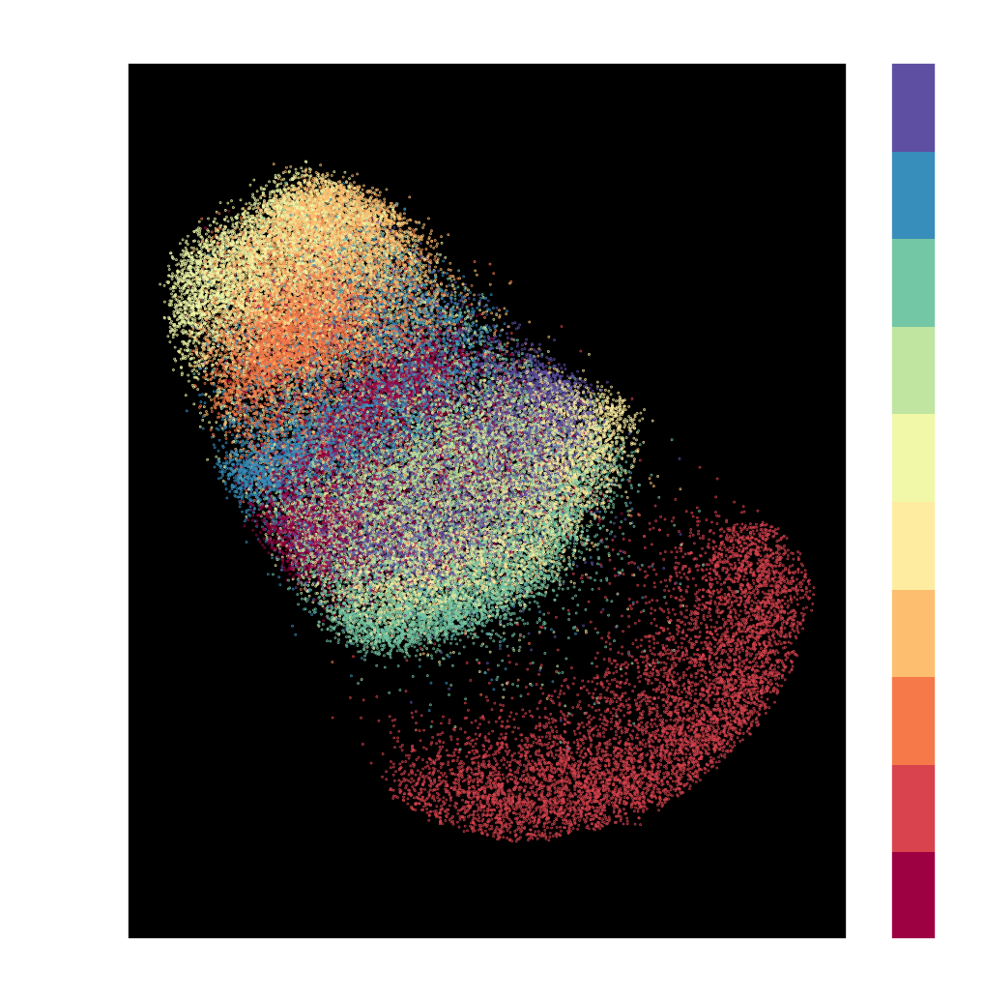

In [10]:
fig = plt.figure(figsize=(8,8),dpi=150)
plt.scatter(embedding[:, 0], embedding[:, 1], c=mnist_train_y, cmap='Spectral', s=0.1)
plt.gca().set_aspect('equal', 'datalim')
plt.colorbar(boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
plt.title('UMAP projection of the Digits dataset', fontsize=24);

Start doing this seriously.

In [11]:
sc=StandardScaler()
reducer = umap.UMAP(random_state=42)
reducer.fit(sc.fit_transform(np.log10(mnist_DHC_out_sizetrain)))

UMAP(dens_frac=0.0, dens_lambda=0.0, random_state=42)

<AxesSubplot:>

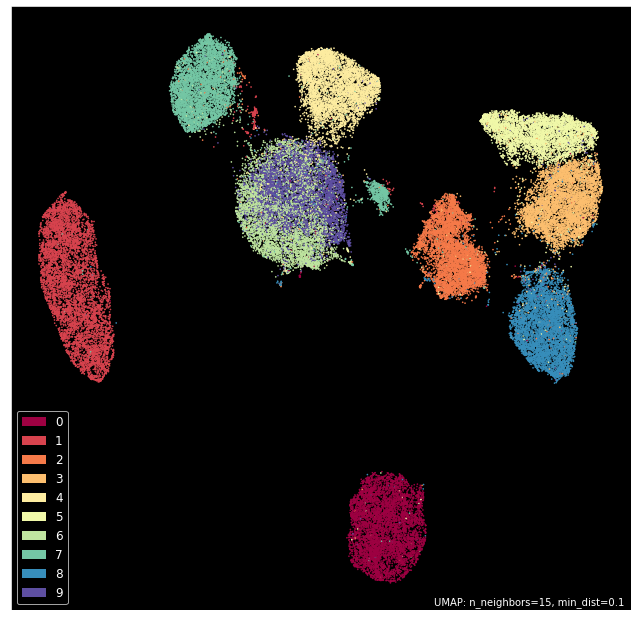

In [14]:
umap.plot.points(reducer,labels=mnist_train_y,background='black')

In [15]:
sc=StandardScaler()
reducer1 = umap.UMAP(random_state=42)
reducer1.fit(np.log10(mnist_DHC_out_sizetrain))

UMAP(dens_frac=0.0, dens_lambda=0.0, random_state=42)

<AxesSubplot:>

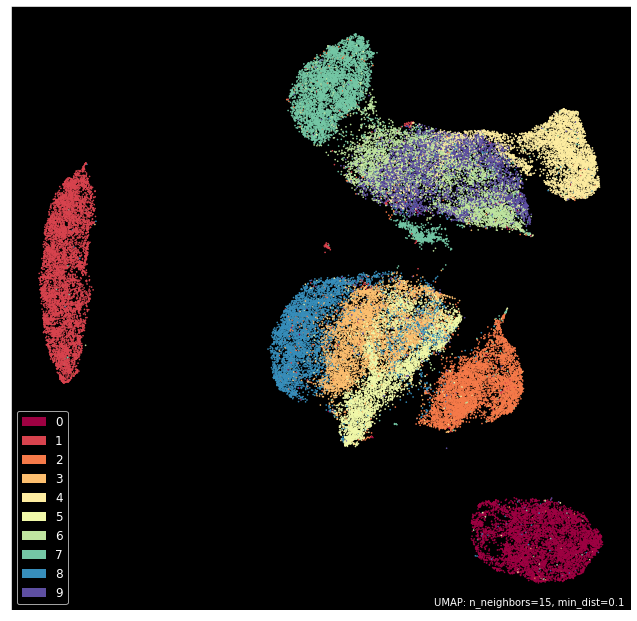

In [16]:
umap.plot.points(reducer1,labels=mnist_train_y,background='black')

In [17]:
reducer2 = umap.UMAP(random_state=42)
reducer2.fit(mnist_DHC_out_sizetrain)

UMAP(dens_frac=0.0, dens_lambda=0.0, random_state=42)

<AxesSubplot:>

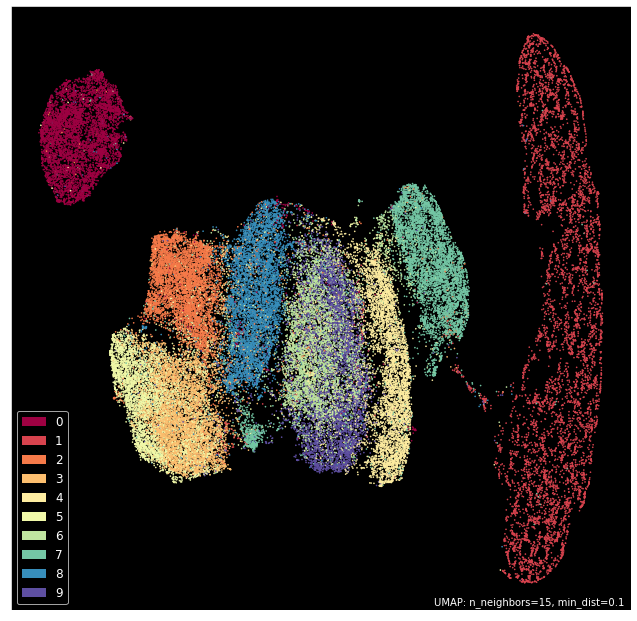

In [18]:
umap.plot.points(reducer2,labels=mnist_train_y,background='black')

In [19]:
lda = LDA(n_components=9)
X_train = lda.fit_transform(sc.fit_transform(np.log10(mnist_DHC_out_sizetrain)), mnist_train_y)

In [26]:
X_test = lda.transform(sc.transform(np.log10(mnist_DHC_out_sizetest)))

In [20]:
reducer3 = umap.UMAP(random_state=42)
reducer3.fit(X_train)

UMAP(dens_frac=0.0, dens_lambda=0.0, random_state=42)

<AxesSubplot:>

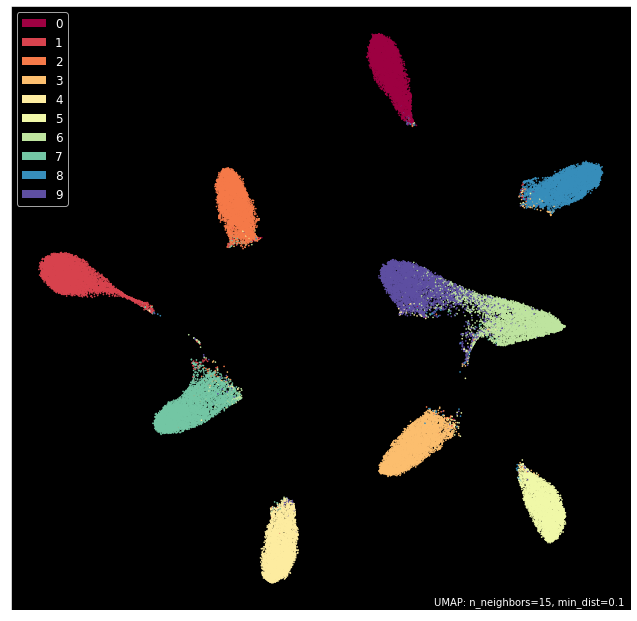

In [21]:
umap.plot.points(reducer3,labels=mnist_train_y,background='black')

In [22]:
reducer4 = umap.UMAP(random_state=42)
reducer4.fit(X_train,y=mnist_train_y)

UMAP(dens_frac=0.0, dens_lambda=0.0, random_state=42)

<AxesSubplot:>

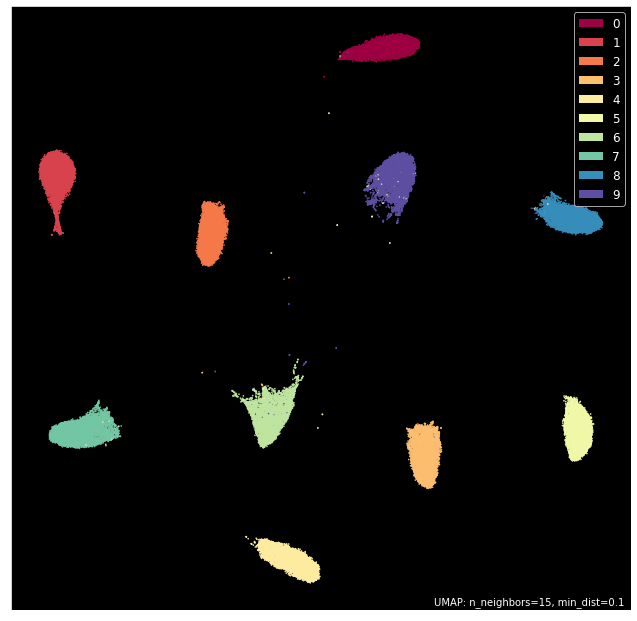

In [24]:
umap.plot.points(reducer4,labels=mnist_train_y,background='black')

In [29]:
emb = reducer4.transform(X_test)

inside function
   (0, 13847)	0.30805373
  (0, 24572)	0.28456333
  (0, 26010)	0.2641829
  (0, 27983)	0.3019177
  (0, 29297)	0.26333958
  (0, 32893)	0.28830546
  (0, 34435)	0.40940964
  (0, 37133)	0.25142682
  (0, 38244)	0.28548017
  (0, 40436)	0.2502126
  (0, 41232)	0.28306192
  (0, 41660)	0.336762
  (0, 45973)	0.25067568
  (0, 47067)	0.26342183
  (0, 50215)	0.2754911
  (1, 4706)	0.27532035
  (1, 5909)	0.23119082
  (1, 7370)	0.33420637
  (1, 7523)	0.29976928
  (1, 10300)	0.23309088
  (1, 31092)	0.3137182
  (1, 31617)	0.25347406
  (1, 37418)	0.23434514
  (1, 38924)	0.34794524
  (1, 42474)	0.28512415
  :	:
  (9998, 15812)	0.26017302
  (9998, 25356)	0.26436204
  (9998, 26876)	0.26850334
  (9998, 27403)	0.2620648
  (9998, 42560)	0.25650248
  (9998, 44501)	0.318423
  (9998, 48826)	0.26312405
  (9998, 54659)	0.33139417
  (9998, 54902)	0.26287112
  (9998, 59790)	0.3393908
  (9999, 3449)	0.26229885
  (9999, 5099)	0.27747032
  (9999, 5766)	0.28919494
  (9999, 8720)	0.26610324
  (9999, 12002)	0.

([], [])

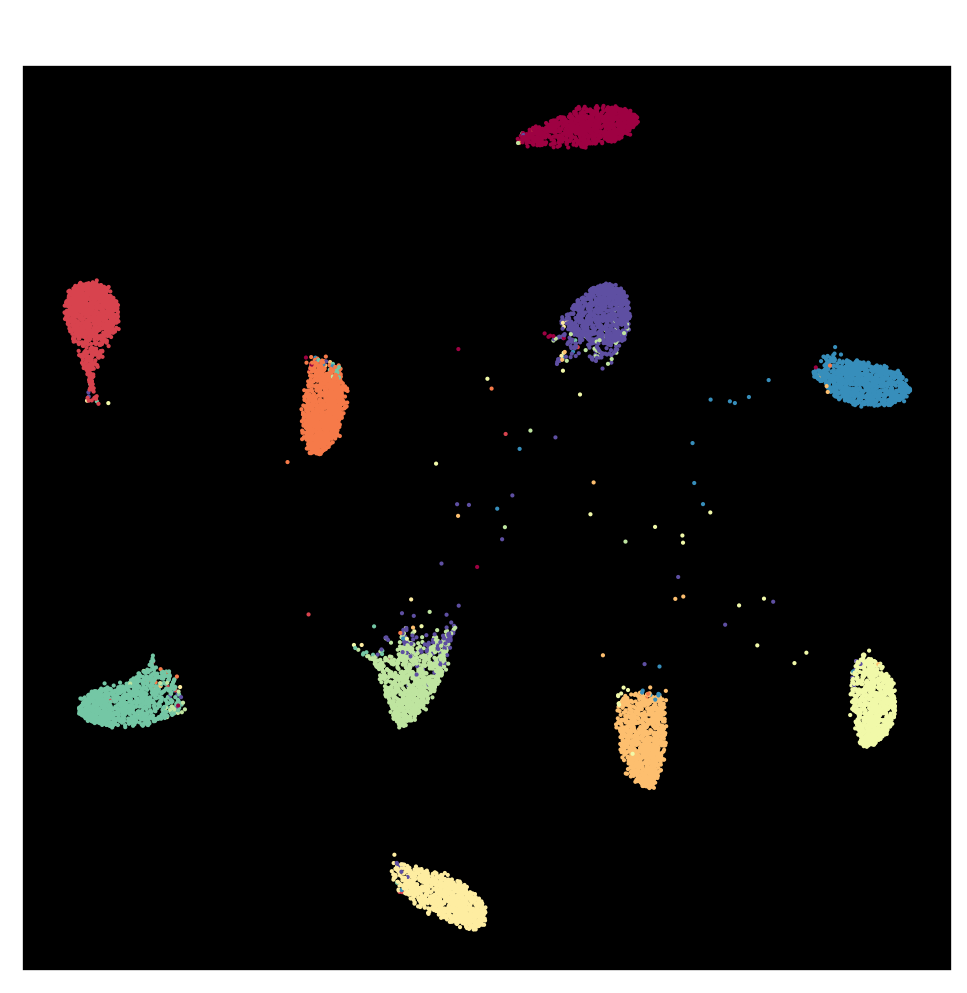

In [36]:
fig = plt.figure(figsize=(8,8),dpi=150)
plt.scatter(emb[:, 0], emb[:, 1], s= 1, c=mnist_test_y, cmap='Spectral')
plt.title('Embedding of the test set by UMAP', fontsize=24);
plt.xticks([])
plt.yticks([])

In [37]:
reducer5 = umap.UMAP(random_state=42)
reducer5.fit(sc.fit_transform(np.log10(mnist_DHC_out_sizetrain)),y=mnist_train_y)

UMAP(dens_frac=0.0, dens_lambda=0.0, random_state=42)

<AxesSubplot:>

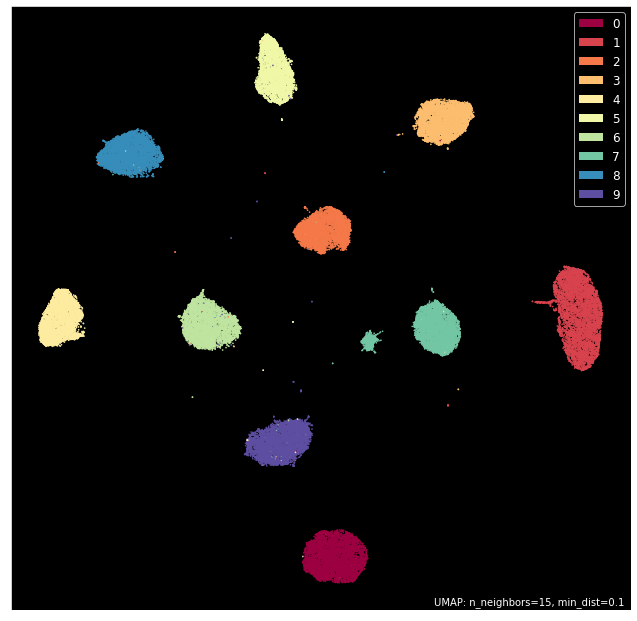

In [38]:
umap.plot.points(reducer5,labels=mnist_train_y,background='black')

In [40]:
emb5 = reducer5.transform(sc.fit_transform(np.log10(mnist_DHC_out_sizetest)))

inside function
   (0, 3298)	0.26712027
  (0, 13048)	0.26375234
  (0, 14505)	0.2620037
  (0, 14563)	0.27554446
  (0, 21217)	0.3207371
  (0, 30502)	0.2769708
  (0, 32613)	0.27641588
  (0, 37298)	0.2690906
  (0, 45374)	0.28423482
  (0, 48250)	0.28268912
  (0, 50255)	0.27443245
  (0, 53783)	0.26908404
  (0, 53843)	0.32406068
  (0, 53886)	0.26288548
  (0, 58733)	0.32192665
  (1, 1609)	0.29012302
  (1, 15368)	0.2653493
  (1, 17757)	0.29731295
  (1, 20078)	0.26358238
  (1, 24612)	0.283316
  (1, 26357)	0.2962607
  (1, 28882)	0.28443345
  (1, 31634)	0.2711116
  (1, 31956)	0.2646829
  (1, 32981)	0.30492467
  :	:
  (9998, 6389)	0.26892027
  (9998, 11055)	0.264189
  (9998, 17217)	0.26326522
  (9998, 22846)	0.2639957
  (9998, 31979)	0.2935498
  (9998, 33247)	0.28734112
  (9998, 36407)	0.26140654
  (9998, 36683)	0.2638789
  (9998, 47021)	0.31327575
  (9998, 54673)	0.2867492
  (9999, 2523)	0.29512236
  (9999, 2545)	0.27667066
  (9999, 5159)	0.24684756
  (9999, 5179)	0.29407227
  (9999, 5273)	0.29854

([], [])

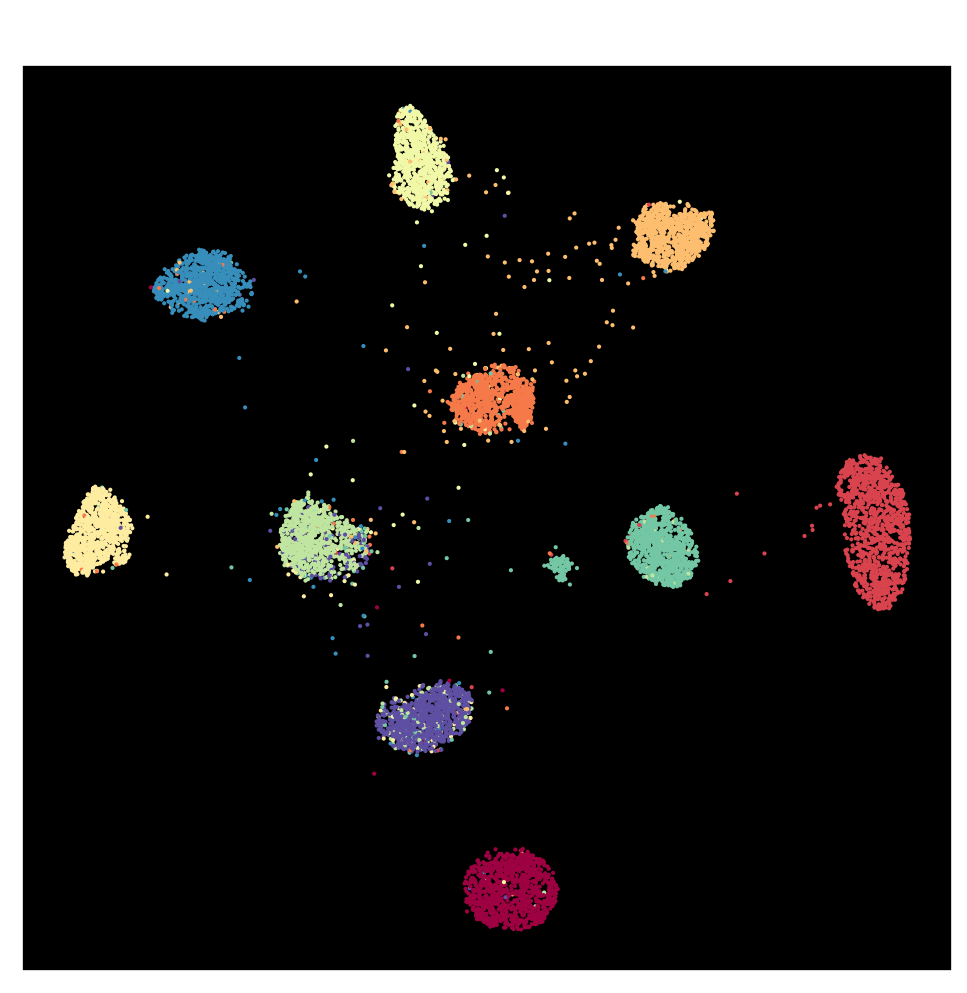

In [41]:
fig = plt.figure(figsize=(8,8),dpi=150)
plt.scatter(emb5[:, 0], emb5[:, 1], s= 1, c=mnist_test_y, cmap='Spectral')
plt.title('Embedding of the test set by UMAP', fontsize=24);
plt.xticks([])
plt.yticks([])

In [45]:
reducer6 = umap.UMAP(n_neighbors = 10, random_state=42)
reducer6.fit(sc.fit_transform(np.log10(mnist_DHC_out_sizetrain)))

UMAP(dens_frac=0.0, dens_lambda=0.0, n_neighbors=10, random_state=42)

<AxesSubplot:>

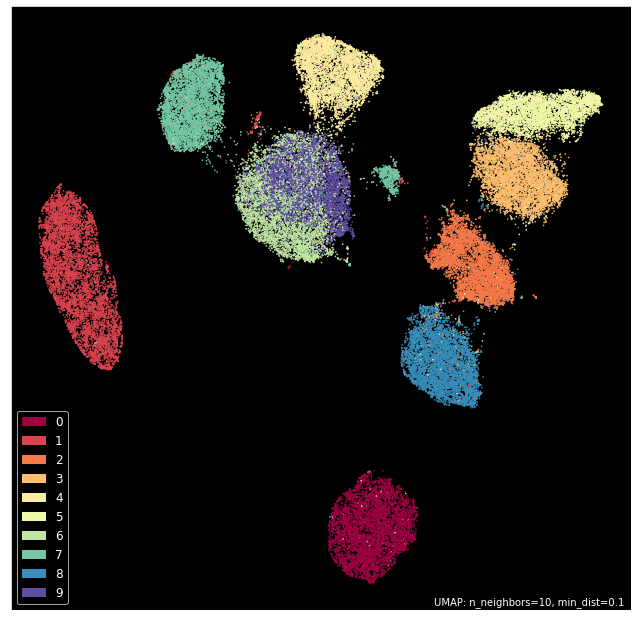

In [46]:
umap.plot.points(reducer6,labels=mnist_train_y,background='black')

In [47]:
reducer7 = umap.UMAP(n_neighbors = 5, random_state=42)
reducer7.fit(sc.fit_transform(np.log10(mnist_DHC_out_sizetrain)))

UMAP(dens_frac=0.0, dens_lambda=0.0, n_neighbors=5, random_state=42)

<AxesSubplot:>

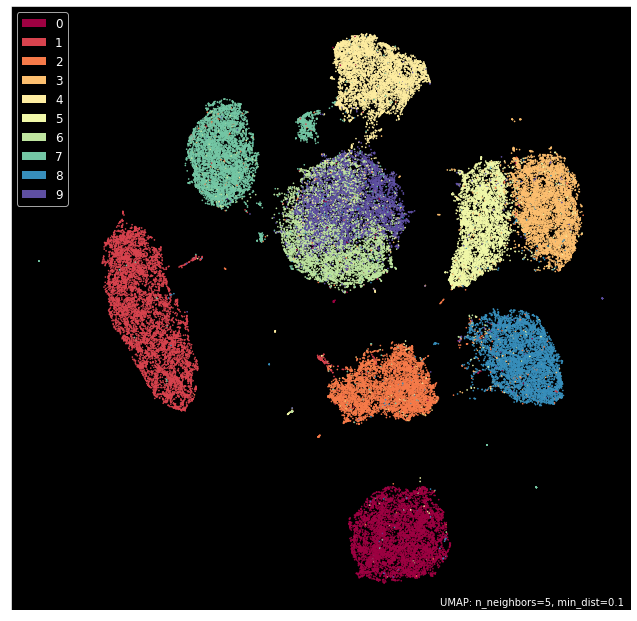

In [48]:
umap.plot.points(reducer7,labels=mnist_train_y,background='black')

In [49]:
reducer8 = umap.UMAP(n_neighbors = 3, random_state=42)
reducer8.fit(sc.fit_transform(np.log10(mnist_DHC_out_sizetrain)))

/opt/miniconda3/envs/IWST/lib/python3.8/site-packages/sklearn/manifold/_spectral_embedding.py:245: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


UMAP(dens_frac=0.0, dens_lambda=0.0, n_neighbors=3, random_state=42)

<AxesSubplot:>

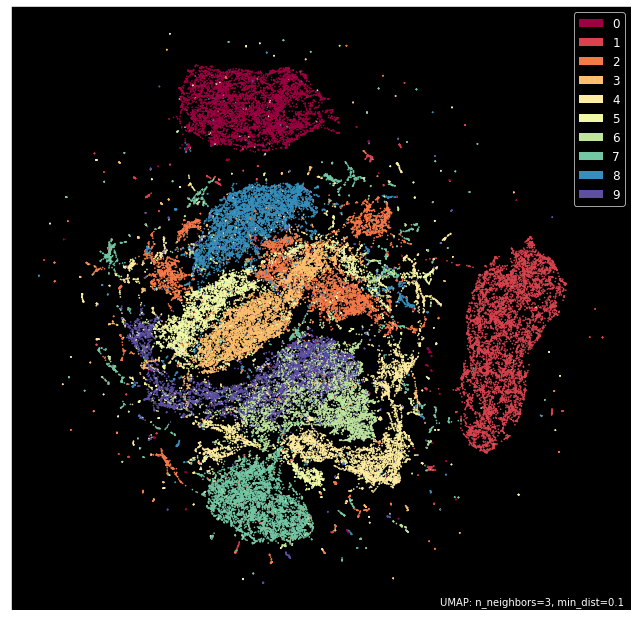

In [50]:
umap.plot.points(reducer8,labels=mnist_train_y,background='black')

In [36]:
X_train_log = sc.fit_transform(np.log10(mnist_DHC_out_sizetrain))

In [52]:
reducer9 = umap.UMAP(n_neighbors = 30, random_state=42)
reducer9.fit(X_train_log)

UMAP(dens_frac=0.0, dens_lambda=0.0, n_neighbors=30, random_state=42)

<AxesSubplot:>

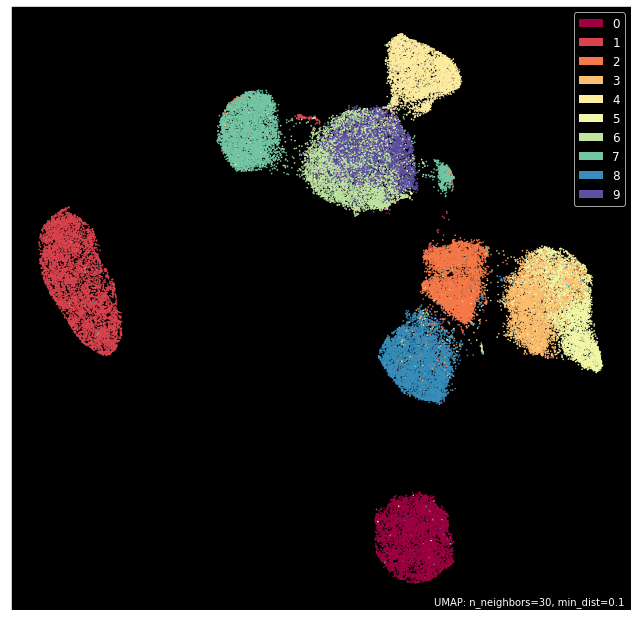

In [53]:
umap.plot.points(reducer9,labels=mnist_train_y,background='black')

In [54]:
reducer10 = umap.UMAP(n_neighbors = 50, random_state=42)
reducer10.fit(X_train_log)

UMAP(dens_frac=0.0, dens_lambda=0.0, n_neighbors=50, random_state=42)

<AxesSubplot:>

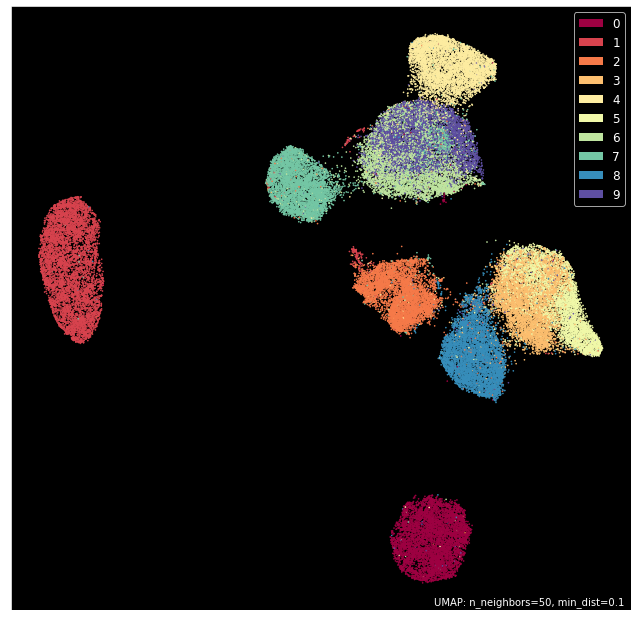

In [55]:
umap.plot.points(reducer10,labels=mnist_train_y,background='black')

In [56]:
reducer11 = umap.UMAP(n_neighbors = 100, random_state=42)
reducer11.fit(X_train_log)

UMAP(dens_frac=0.0, dens_lambda=0.0, n_neighbors=100, random_state=42)

<AxesSubplot:>

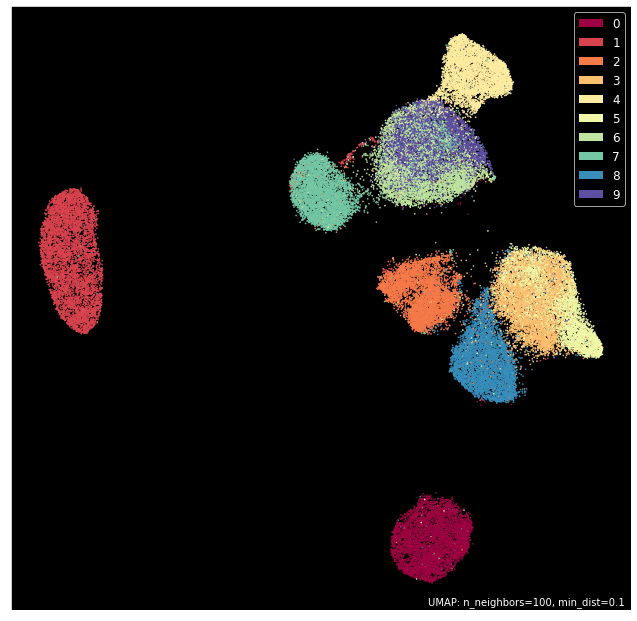

In [57]:
umap.plot.points(reducer11,labels=mnist_train_y,background='black')

In [58]:
reducer12 = umap.UMAP(n_neighbors = 500, random_state=42)
reducer12.fit(X_train_log)

UMAP(dens_frac=0.0, dens_lambda=0.0, n_neighbors=500, random_state=42)

<AxesSubplot:>

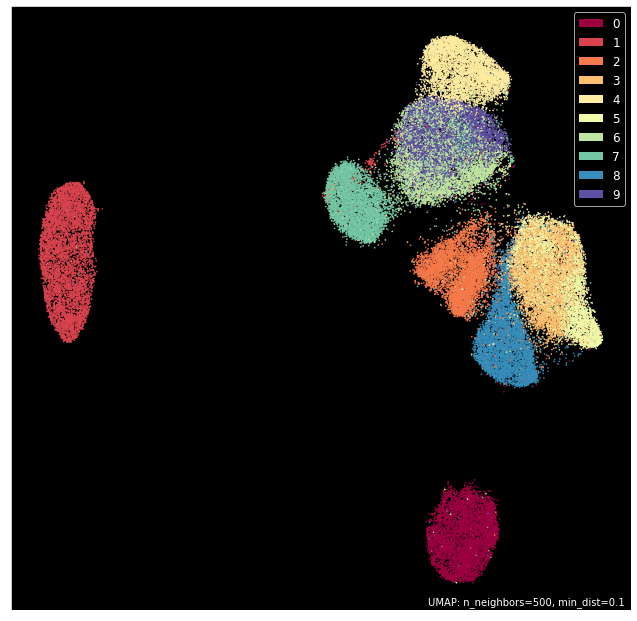

In [59]:
umap.plot.points(reducer12,labels=mnist_train_y,background='black')

In [60]:
reducer13 = umap.UMAP(n_neighbors=15, random_state=42, min_dist=0)
reducer13.fit(X_train_log)

UMAP(dens_frac=0.0, dens_lambda=0.0, min_dist=0, random_state=42)

<AxesSubplot:>

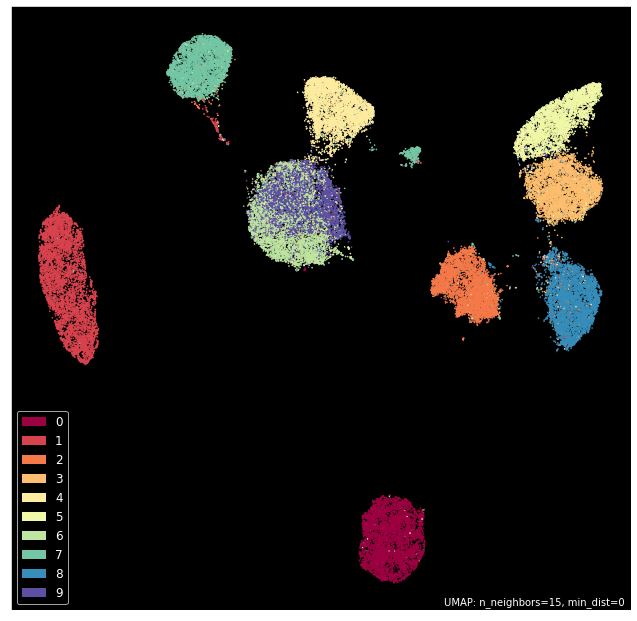

In [61]:
umap.plot.points(reducer13,labels=mnist_train_y,background='black')

In [62]:
reducer14 = umap.UMAP(n_neighbors=15, random_state=42, min_dist=0.5)
reducer14.fit(X_train_log)

UMAP(dens_frac=0.0, dens_lambda=0.0, min_dist=0.5, random_state=42)

<AxesSubplot:>

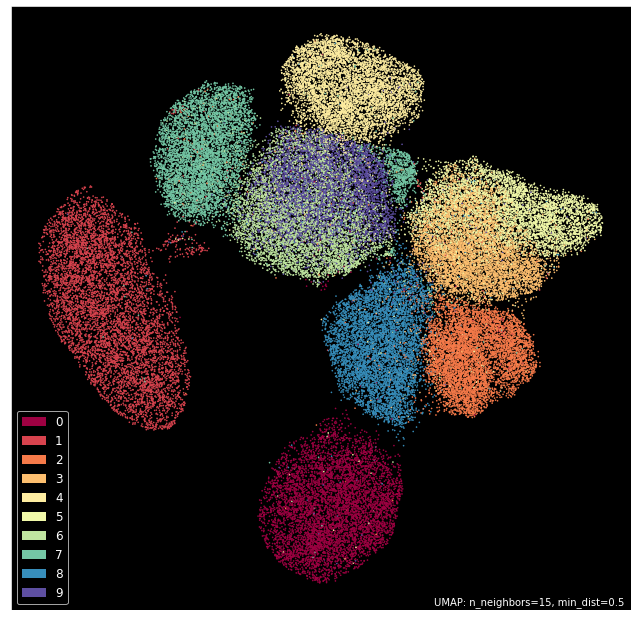

In [63]:
umap.plot.points(reducer14,labels=mnist_train_y,background='black')

In [64]:
reducer15 = umap.UMAP(n_neighbors=15, random_state=42, min_dist=0.1,n_components=3)
reducer15.fit(X_train_log)

UMAP(dens_frac=0.0, dens_lambda=0.0, n_components=3, random_state=42)

In [66]:
emb15 = reducer15.embedding_

([], [])

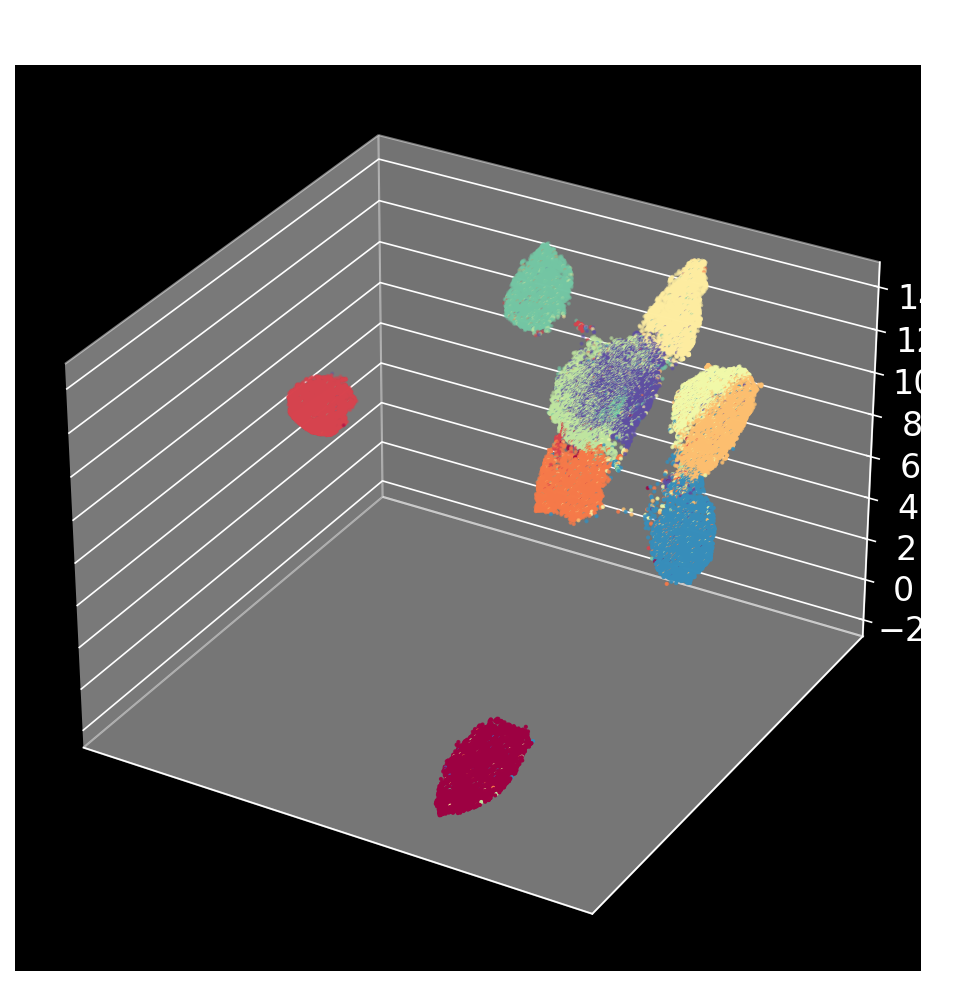

In [68]:
fig = plt.figure(figsize=(8,8),dpi=150)
ax = fig.add_subplot(111,projection='3d')
ax.scatter(emb15[:, 0], emb15[:, 1], emb15[:, 1], s= 1, c=mnist_train_y, cmap='Spectral')
plt.title('Embedding of the test set by UMAP', fontsize=24);
plt.xticks([])
plt.yticks([])

In [70]:
import plotly.graph_objects as go
import scipy.interpolate

In [82]:
##
traces = []
trace = go.Scatter3d(
    x=emb15[:, 0], y=emb15[:, 1], z=emb15[:, 2],
    mode='markers',
    #hovertext=mnist_train_y,
    #hoverinfo="text",
    #cmap_attribute=mnist_train_y,
    #cmap="Spectral",
    opacity=1.0,
)
traces.append(trace)

fig = go.Figure(data=traces)
fig.update_layout(
    width=800,
    height=600,
    scene=dict(
        aspectratio = dict( x=0.5, y=1.25, z=0.5 ),
        yaxis_title="Year",
        xaxis_title="UMAP-X",
        zaxis_title="UMAP-Y",
    ),
    scene_camera=dict(eye=dict( x=0.5, y=0.8, z=0.75 )),
    autosize=False,
    showlegend=False,
)
fig_widget = go.FigureWidget(fig)
fig_widget

FigureWidget({
    'data': [{'mode': 'markers',
              'opacity': 1.0,
              'type': 'scatter3d…

([], [])

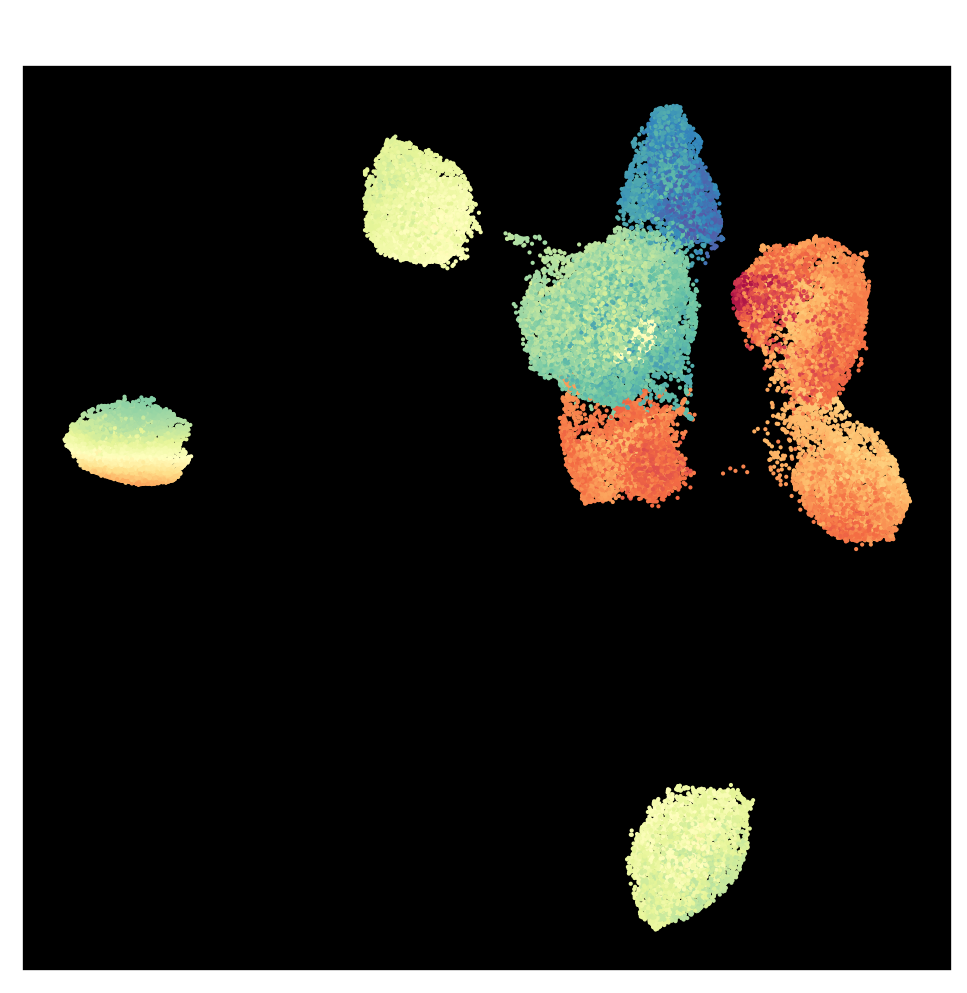

In [89]:
fig = plt.figure(figsize=(8,8),dpi=150)
ax = fig.add_subplot(111)
ax.scatter(emb15[:, 0], emb15[:, 1], s= 1, c=emb15[:, 2], cmap='Spectral')
plt.title('N = 3', fontsize=24);
plt.xticks([])
plt.yticks([])

In [84]:
em_0 = reducer.embedding_

([], [])

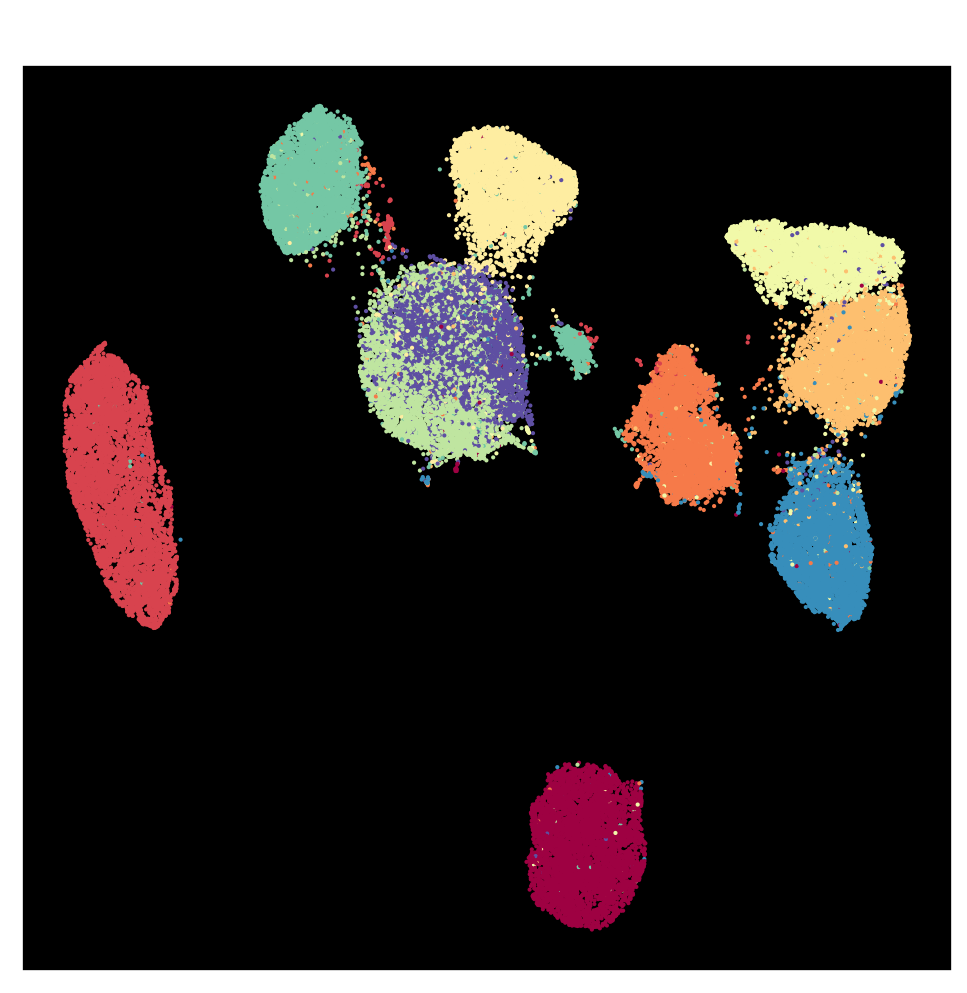

In [86]:
fig = plt.figure(figsize=(8,8),dpi=150)
ax = fig.add_subplot(111)
ax.scatter(em_0[:, 0], em_0[:, 1], s= 1, c=mnist_train_y, cmap='Spectral')
plt.title('N = 2', fontsize=24);
plt.xticks([])
plt.yticks([])

In [88]:
reducer16 = umap.UMAP(n_neighbors=15, random_state=42, min_dist=0.1,n_components=4)
reducer16.fit(X_train_log)
emb16 = reducer16.embedding_

([], [])

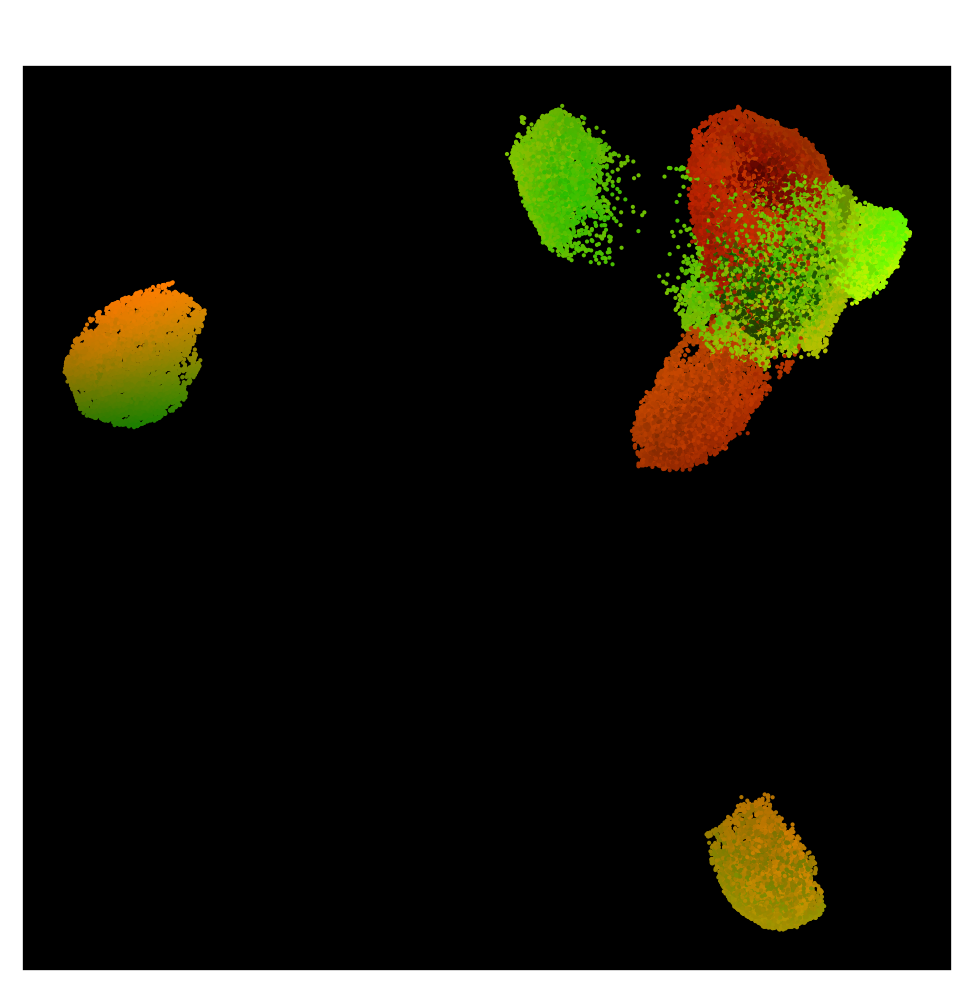

In [101]:
fig = plt.figure(figsize=(8,8),dpi=150)
ax = fig.add_subplot(111)
x=emb16[:, 2:4]
norm = (x-np.min(x,axis=0))/(np.max(x,axis=0)-np.min(x,axis=0))
c_1 = np.hstack((norm,np.zeros((60000,1))))
ax.scatter(emb16[:, 0], emb16[:, 1], s= 1, c=c_1)
plt.title('N = 4', fontsize=24);
plt.xticks([])
plt.yticks([])

([], [])

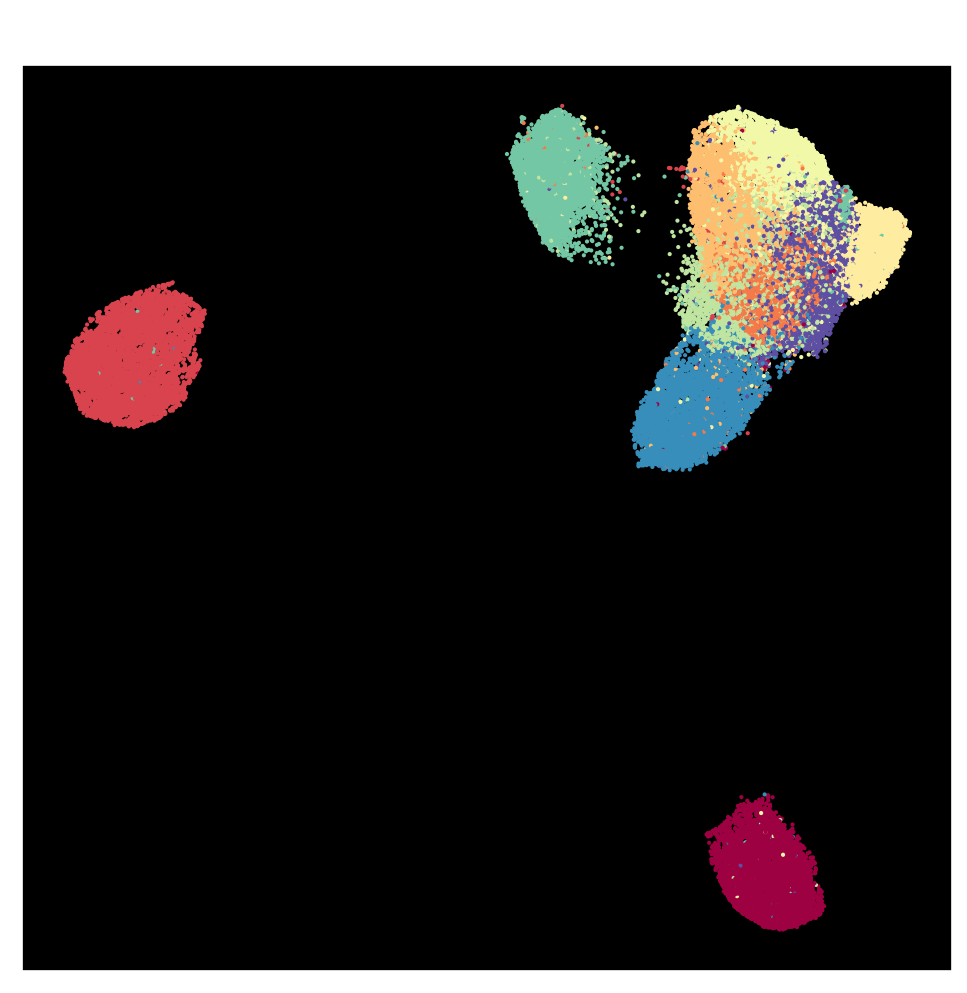

In [102]:
fig = plt.figure(figsize=(8,8),dpi=150)
ax = fig.add_subplot(111)
x=emb16[:, 2:4]
norm = (x-np.min(x,axis=0))/(np.max(x,axis=0)-np.min(x,axis=0))
c_1 = np.hstack((norm,np.zeros((60000,1))))
ax.scatter(emb16[:, 0], emb16[:, 1], s= 1, c=mnist_train_y, cmap='Spectral')
plt.title('N = 4', fontsize=24);
plt.xticks([])
plt.yticks([])

([], [])

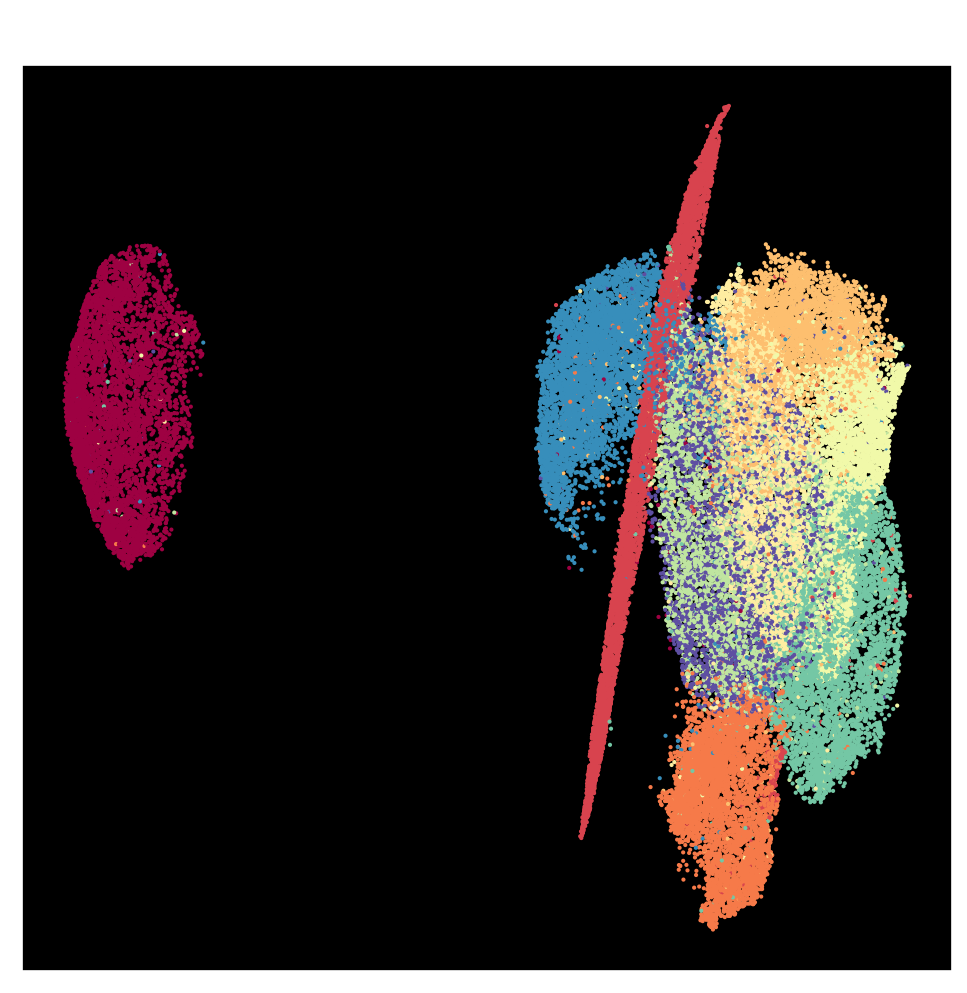

In [103]:
fig = plt.figure(figsize=(8,8),dpi=150)
ax = fig.add_subplot(111)
x=emb16[:, 2:4]
norm = (x-np.min(x,axis=0))/(np.max(x,axis=0)-np.min(x,axis=0))
c_1 = np.hstack((norm,np.zeros((60000,1))))
ax.scatter(emb16[:, 1], emb16[:, 2], s= 1, c=mnist_train_y, cmap='Spectral')
plt.title('N = 4', fontsize=24);
plt.xticks([])
plt.yticks([])

([], [])

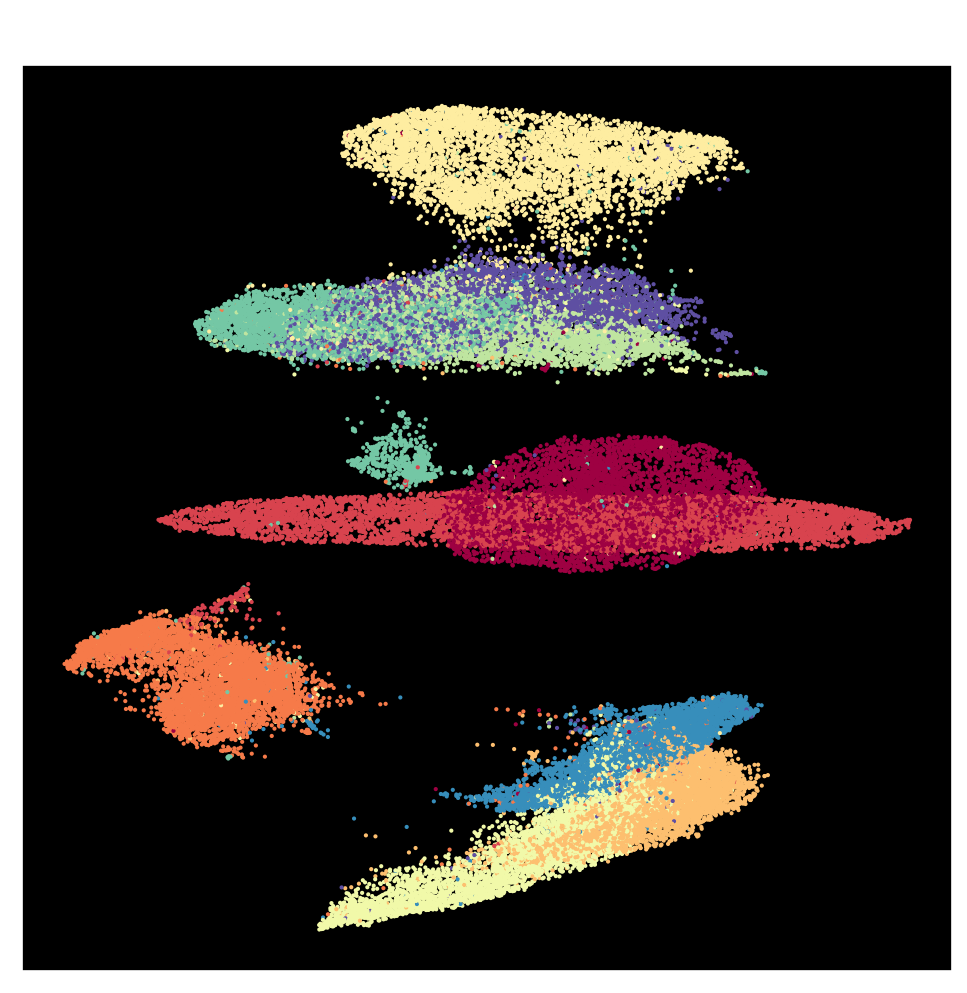

In [104]:
fig = plt.figure(figsize=(8,8),dpi=150)
ax = fig.add_subplot(111)
x=emb16[:, 2:4]
norm = (x-np.min(x,axis=0))/(np.max(x,axis=0)-np.min(x,axis=0))
c_1 = np.hstack((norm,np.zeros((60000,1))))
ax.scatter(emb16[:, 2], emb16[:, 3], s= 1, c=mnist_train_y, cmap='Spectral')
plt.title('N = 4', fontsize=24);
plt.xticks([])
plt.yticks([])

In [106]:
reducer17 = umap.UMAP(n_neighbors=15, random_state=42, min_dist=0.1,n_components=5)
reducer17.fit(X_train_log)
emb17 = reducer17.embedding_

([], [])

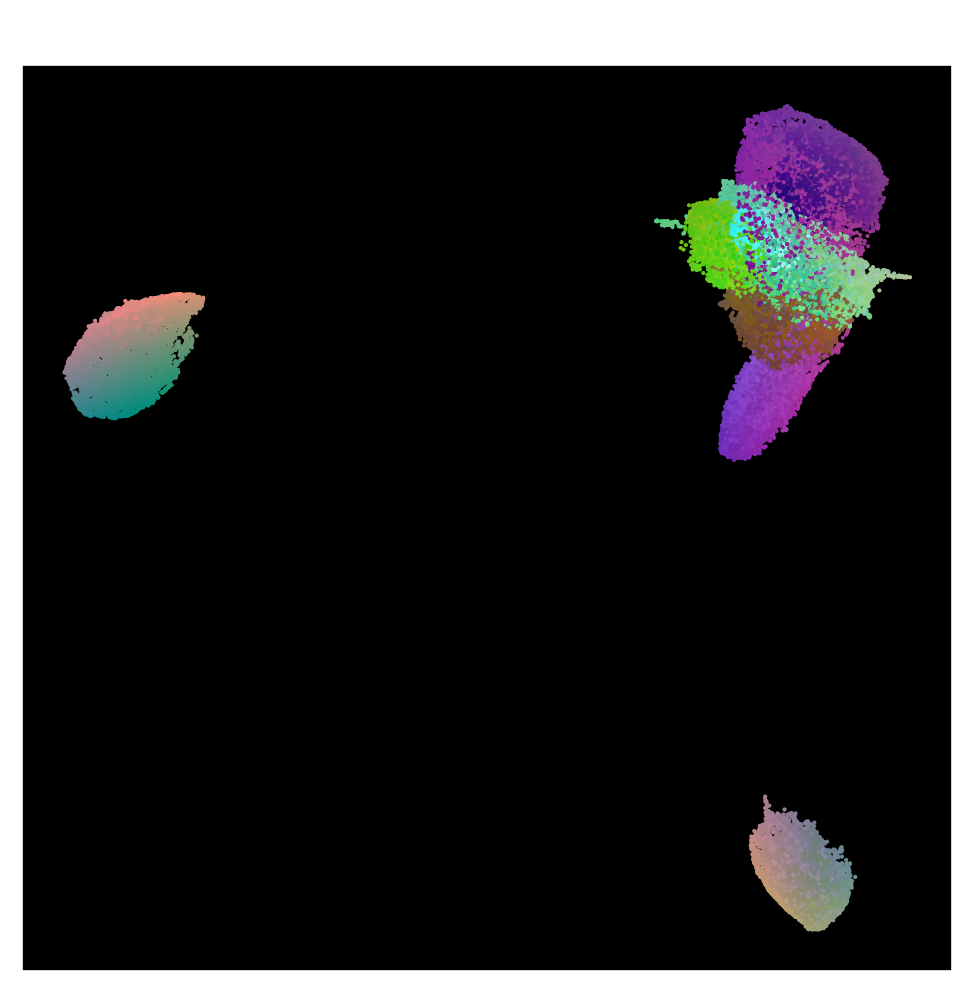

In [107]:
fig = plt.figure(figsize=(8,8),dpi=150)
ax = fig.add_subplot(111)
x=emb17[:, 2:5]
norm = (x-np.min(x,axis=0))/(np.max(x,axis=0)-np.min(x,axis=0))
ax.scatter(emb17[:, 0], emb17[:, 1], s= 1, c=norm)
plt.title('N = 5', fontsize=24);
plt.xticks([])
plt.yticks([])

In [108]:
dens_mapper = umap.UMAP(densmap=True, random_state=42).fit(X_train_log)

<AxesSubplot:>

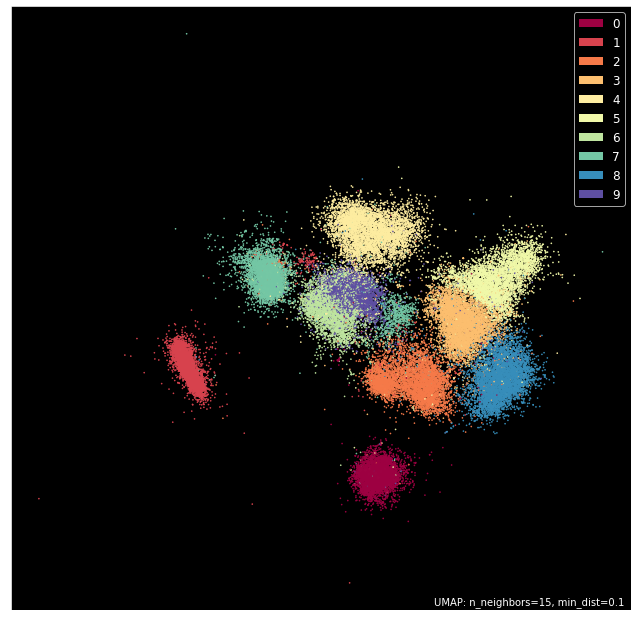

In [109]:
umap.plot.points(dens_mapper,labels=mnist_train_y,background='black')

In [110]:
dens_mapper1 = umap.UMAP(densmap=True, random_state=42,dens_lambda=0.1).fit(X_train_log)

<AxesSubplot:>

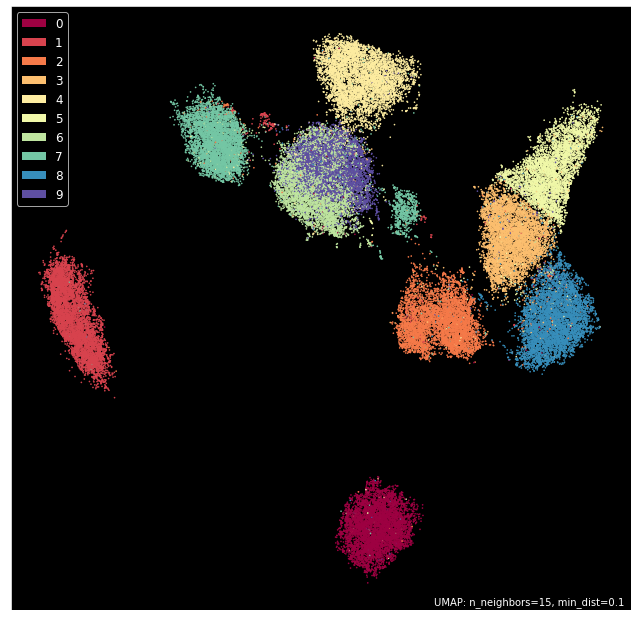

In [111]:
umap.plot.points(dens_mapper1,labels=mnist_train_y,background='black')

In [112]:
dens_mapper2 = umap.UMAP(densmap=True, random_state=42,dens_lambda=5).fit(X_train_log)

<AxesSubplot:>

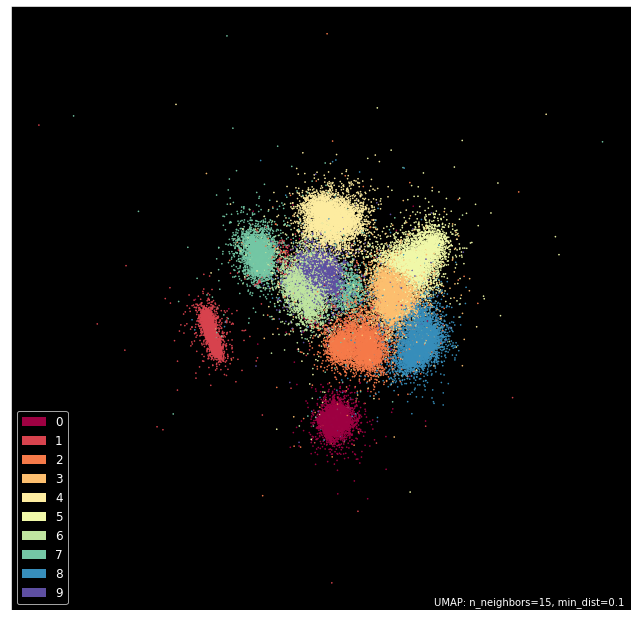

In [113]:
umap.plot.points(dens_mapper2,labels=mnist_train_y,background='black')

In [ ]:
fig = plt.figure(figsize=(8,8),dpi=150)
ax = fig.add_subplot(111)
ax.scatter(em_0[:, 0], em_0[:, 1], s= 1, c=mnist_train_y, cmap='Spectral')
plt.title('N = 2', fontsize=24);
plt.xticks([])
plt.yticks([])

In [115]:
em_0[:,0].min(),em_0[:,0].max(),em_0[:,1].min(),em_0[:,1].max()

(-4.4800234, 18.115067, -2.8224773, 15.124294)

In [116]:
corners = np.array([
    [-5, -2],  # 1
    [-7, 15],  # 7
    [18, -2],  # 2
    [18, 15],  # 0
])

test_pts = np.array([
    (corners[0]*(1-x) + corners[1]*x)*(1-y) +
    (corners[2]*(1-x) + corners[3]*x)*y
    for y in np.linspace(0, 1, 10)
    for x in np.linspace(0, 1, 10)
])

In [118]:
inv_transformed_points = reducer.inverse_transform(test_pts)

KeyboardInterrupt: 

In [5]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
import seaborn as sns
import sklearn.datasets
import umap
import umap.plot

In [120]:
data, labels = sklearn.datasets.fetch_openml('mnist_784', version=1, return_X_y=True)
mapper = umap.UMAP(random_state=42).fit(data)

In [130]:
corners = np.array([
    [-5, -5],  # 1
    [5, -2],  # 2
    [-6, 15],  # 7
    [17, 10],  # 0
])

test_pts = np.array([
    (corners[0]*(1-x) + corners[1]*x)*(1-y) +
    (corners[2]*(1-x) + corners[3]*x)*y
    for y in np.linspace(0, 1, 10)
    for x in np.linspace(0, 1, 10)
])

In [131]:
inv_transformed_points = mapper.inverse_transform(test_pts)

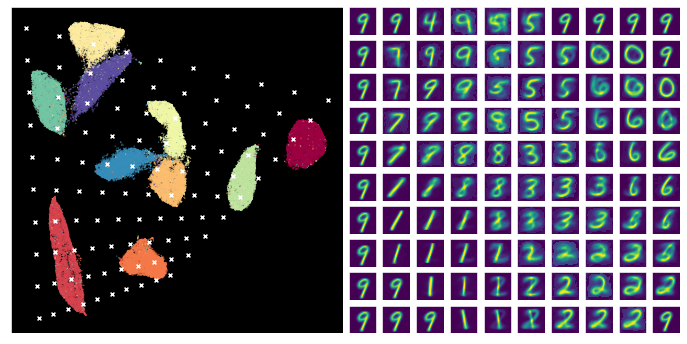

In [135]:
# Set up the grid
fig = plt.figure(figsize=(12,6))
gs = GridSpec(10, 20, fig)
scatter_ax = fig.add_subplot(gs[:, :10])
digit_axes = np.zeros((10, 10), dtype=object)
for i in range(10):
    for j in range(10):
        digit_axes[i, j] = fig.add_subplot(gs[i, 10 + j])

# Use umap.plot to plot to the major axis
# umap.plot.points(mapper, labels=labels, ax=scatter_ax)
scatter_ax.scatter(mapper.embedding_[:, 0], mapper.embedding_[:, 1],
                   c=labels.astype(np.int32), cmap='Spectral', s=0.1)
scatter_ax.set(xticks=[], yticks=[])

# Plot the locations of the text points
scatter_ax.scatter(test_pts[:, 0], test_pts[:, 1], marker='x', c='w', s=15)

# Plot each of the generated digit images
for i in range(10):
    for j in range(10):
        digit_axes[i, j].imshow(inv_transformed_points[(9-i)*10 + j].reshape(28, 28))
        digit_axes[i, j].set(xticks=[], yticks=[])

In [6]:
mnist_DHC_out_sizetrain = hd5_open('../from_cannon/2021_01_21/mnist_DHC_train_ang_1_1.h5','main/data')
mnist_DHC_out_sizetest = hd5_open('../from_cannon/2021_01_21/mnist_DHC_test_ang_1_1.h5','main/data')

In [7]:
M = 100
angle_array = [i for i in np.linspace(2*np.pi/M,2*np.pi,M)]
angle_test = np.tile(angle_array,10000)

In [ ]:
train_slice = np.isin(angle_test,np.array(angle_array)[[3,12,22]])
test_slice = np.isin(angle_test,np.array(angle_array)[[0,1,2,4,5,6,7,8,9,10,11,13,14,15,16,17,18,19,20,21,23,24]])

In [8]:
Y_angles = np.repeat(mnist_test_y,100)

In [9]:
train_slice = np.isin(Y_angles,[1])

In [10]:
sc=StandardScaler()
reducer_angle = umap.UMAP(random_state=42)
reducer_angle.fit(sc.fit_transform(np.log10(mnist_DHC_out_sizetest[train_slice])))

/opt/miniconda3/envs/IWST/lib/python3.8/site-packages/sklearn/manifold/_spectral_embedding.py:245: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


UMAP(dens_frac=0.0, dens_lambda=0.0, random_state=42)

<AxesSubplot:>

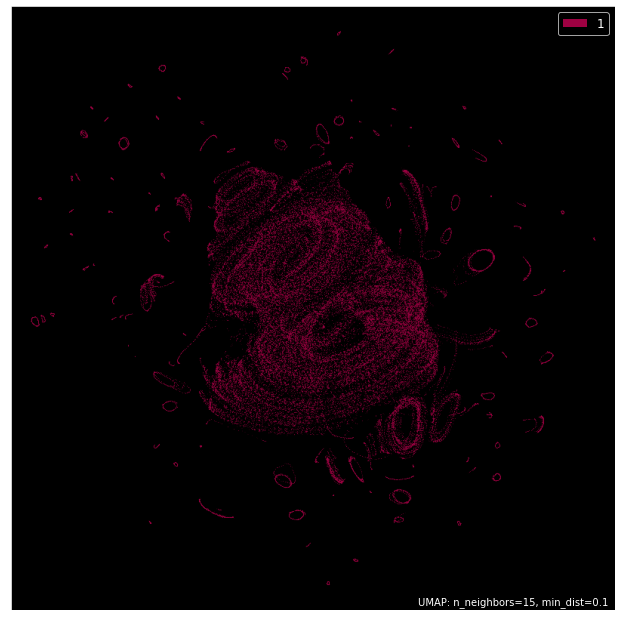

In [13]:
umap.plot.points(reducer_angle,labels=Y_angles[train_slice],background='black')

<AxesSubplot:>

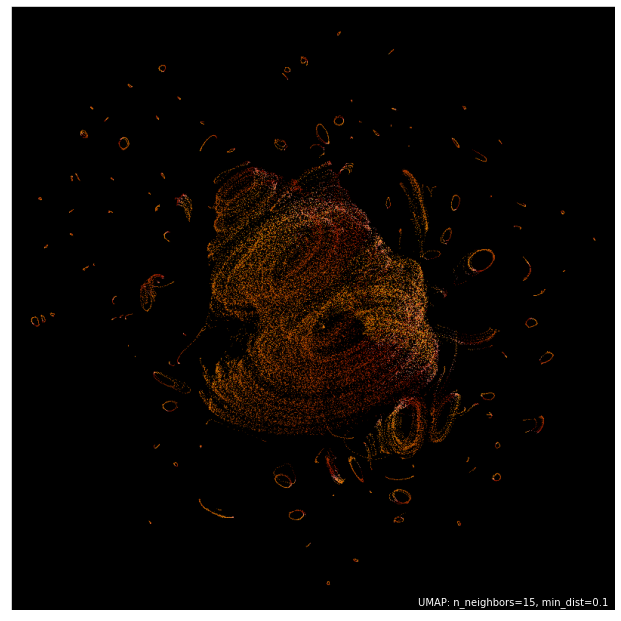

In [30]:
umap.plot.points(reducer_angle,values=angle_test[train_slice],background='black',theme='fire')

In [19]:
Y_angles[train_slice].shape[0]

113500

In [22]:
np.count_nonzero(Y_angles==1),np.count_nonzero(mnist_test_y==1)

(113500, 1135)

In [32]:
sc=StandardScaler()
reducer_angle1 = umap.UMAP(random_state=42)
reducer_angle1.fit(sc.fit_transform(np.log10(mnist_DHC_out_sizetest[train_slice])),y=angle_test[train_slice])

/opt/miniconda3/envs/IWST/lib/python3.8/site-packages/sklearn/manifold/_spectral_embedding.py:245: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


UMAP(dens_frac=0.0, dens_lambda=0.0, random_state=42)

<AxesSubplot:>

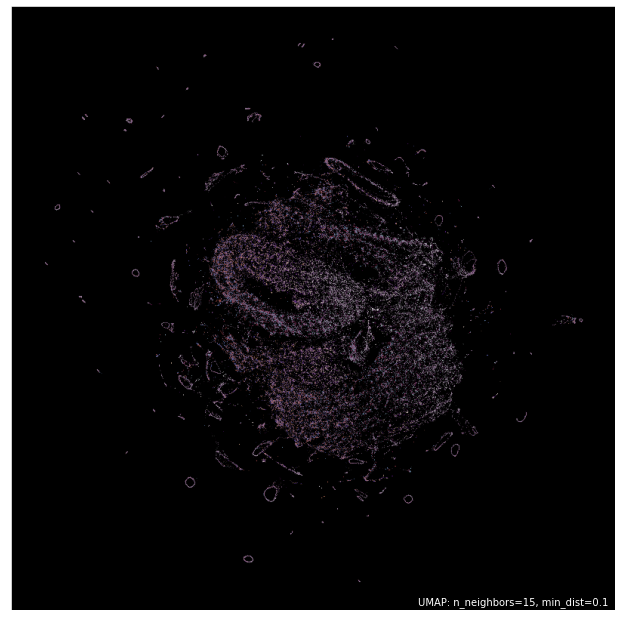

In [33]:
umap.plot.points(reducer_angle1,values=angle_test[train_slice],background='black',cmap='twilight')

In [34]:
#my guess is that this is just a bad metric and we need to use the spherical mapping

In [38]:
sc=StandardScaler()
X_train_log_angles = sc.fit_transform(np.log10(mnist_DHC_out_sizetest[train_slice]))

In [40]:
reducer_angle2 = umap.UMAP(output_metric='haversine',random_state=42).fit(X_train_log_angles,y=angle_test[train_slice])

/opt/miniconda3/envs/IWST/lib/python3.8/site-packages/sklearn/manifold/_spectral_embedding.py:245: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


In [41]:
x = np.sin(reducer_angle2.embedding_[:, 0]) * np.cos(reducer_angle2.embedding_[:, 1])
y = np.sin(reducer_angle2.embedding_[:, 0]) * np.sin(reducer_angle2.embedding_[:, 1])
z = np.cos(reducer_angle2.embedding_[:, 0])

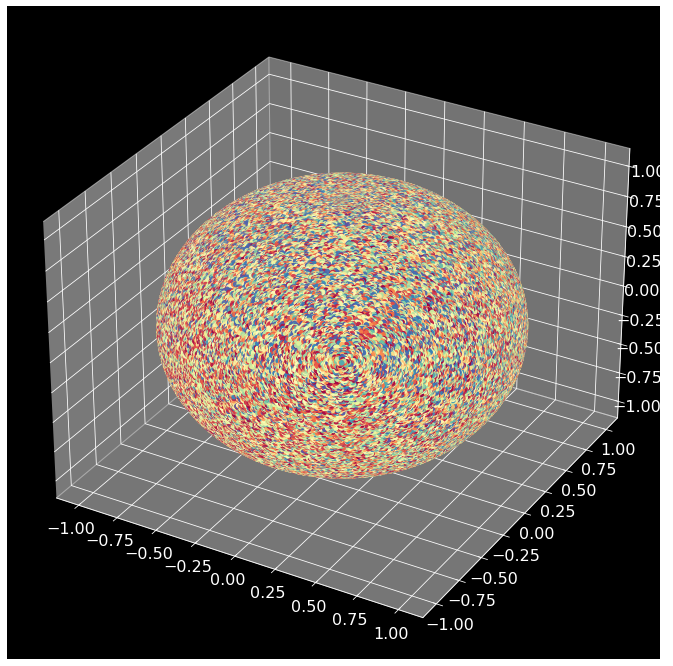

In [44]:
fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(x, y, z, c=angle_test[train_slice], cmap='Spectral')

In [45]:
reducer_angle3 = umap.UMAP(output_metric='haversine',random_state=42,n_neighbors=30).fit(X_train_log_angles)

In [47]:
x = np.sin(reducer_angle3.embedding_[:, 0]) * np.cos(reducer_angle3.embedding_[:, 1])
y = np.sin(reducer_angle3.embedding_[:, 0]) * np.sin(reducer_angle3.embedding_[:, 1])
z = np.cos(reducer_angle3.embedding_[:, 0])

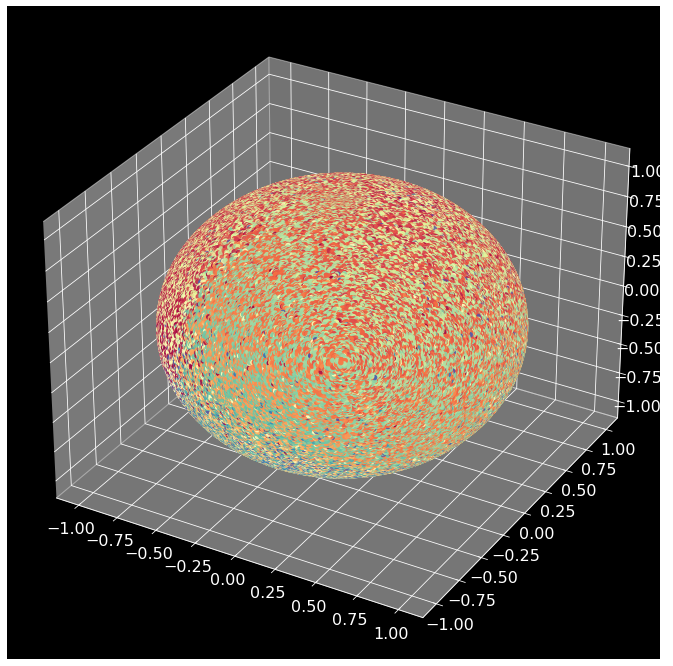

In [48]:
fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(x, y, z, c=angle_test[train_slice], cmap='Spectral')

If this does not work, got to WISE data asap

In [49]:
test_slice = np.logical_and(np.isin(angle_test,np.array(angle_array)[[0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24]]),np.isin(Y_angles,[1]))

In [50]:
np.count_nonzero(test_slice)

28375

In [51]:
sc=StandardScaler()
X_train_log_angles2 = sc.fit_transform(np.log10(mnist_DHC_out_sizetest[test_slice]))

In [52]:
reducer_angle4 = umap.UMAP(output_metric='haversine',random_state=42).fit(X_train_log_angles2,y=angle_test[test_slice])

In [63]:
x = np.sin(reducer_angle4.embedding_[:, 0]) * np.cos(reducer_angle4.embedding_[:, 1])
y = np.sin(reducer_angle4.embedding_[:, 0]) * np.sin(reducer_angle4.embedding_[:, 1])
z = np.cos(reducer_angle4.embedding_[:, 0])

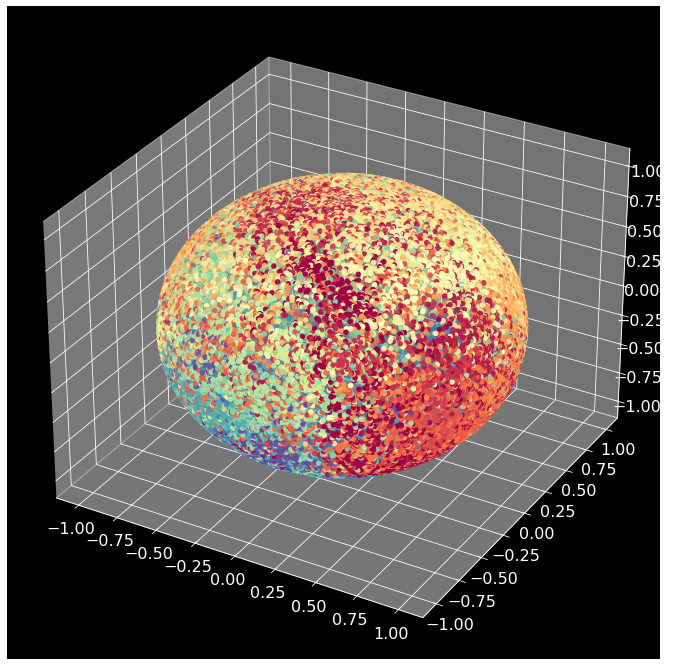

In [54]:
fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(x, y, z, c=angle_test[test_slice], cmap='Spectral')

In [64]:
x = np.arctan2(x, y)
y = -np.arccos(z)

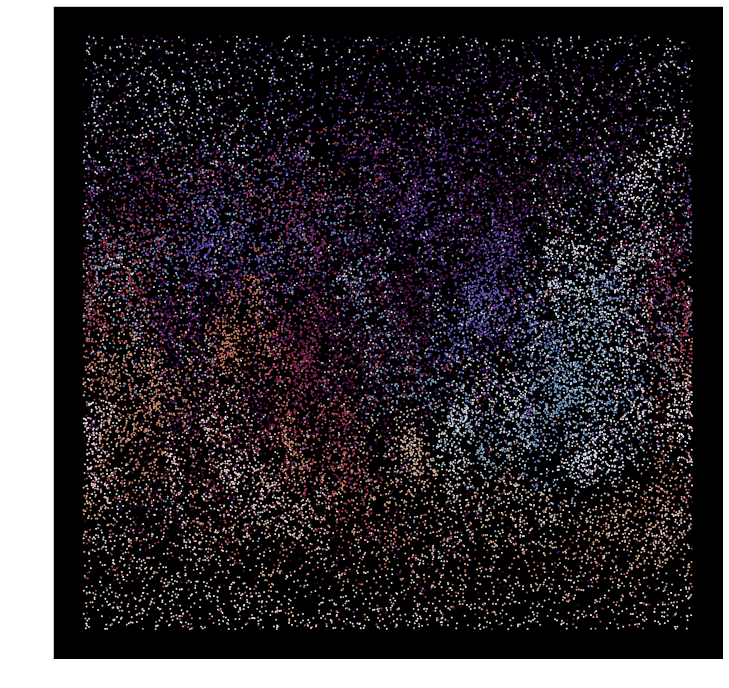

In [65]:
fig = plt.figure(figsize=(12,12))
plt.scatter(x, y, c=angle_test[test_slice], cmap='twilight',s=1)

In [55]:
reducer_angle5 = umap.UMAP(output_metric='haversine',random_state=42).fit(X_train_log_angles2)

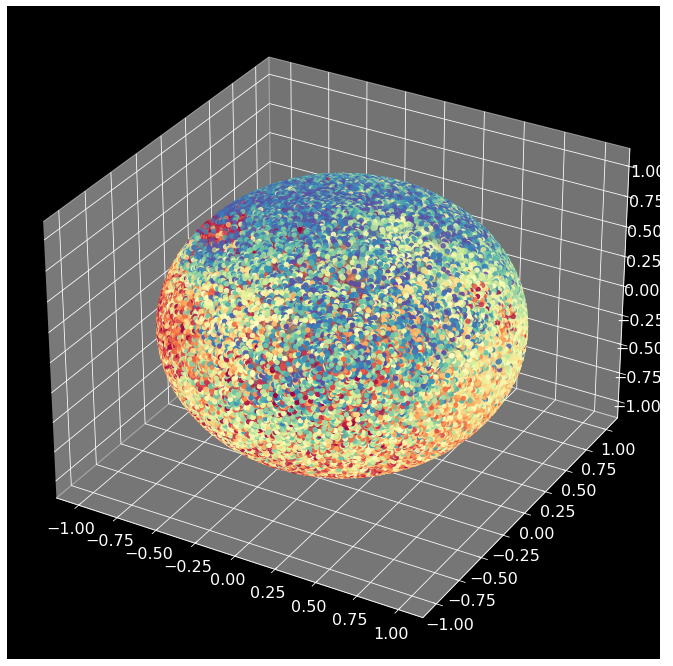

In [56]:
x = np.sin(reducer_angle5.embedding_[:, 0]) * np.cos(reducer_angle5.embedding_[:, 1])
y = np.sin(reducer_angle5.embedding_[:, 0]) * np.sin(reducer_angle5.embedding_[:, 1])
z = np.cos(reducer_angle5.embedding_[:, 0])
fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(x, y, z, c=angle_test[test_slice], cmap='Spectral')

In [57]:
x = np.arctan2(x, y)
y = -np.arccos(z)

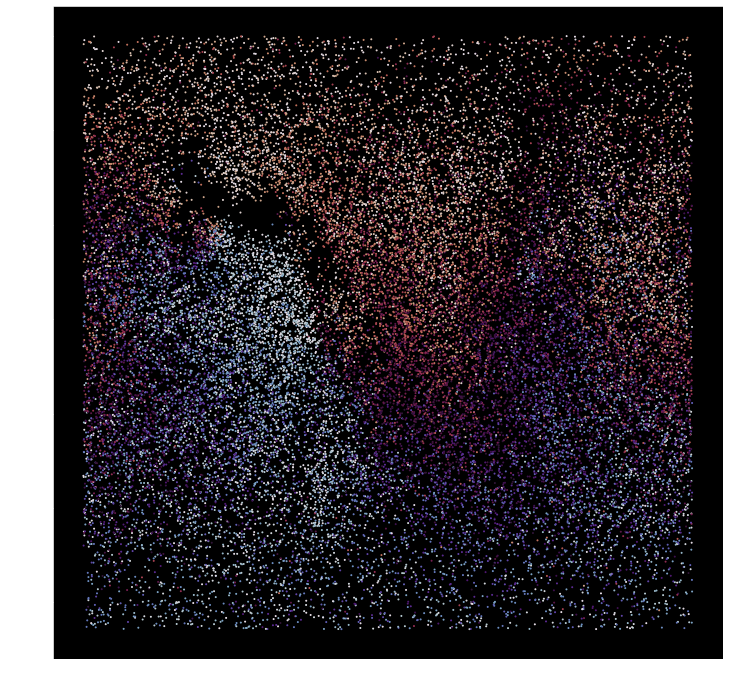

In [62]:
fig = plt.figure(figsize=(12,12))
plt.scatter(x, y, c=angle_test[test_slice], cmap='twilight',s=1)

In [66]:
test_slice2 = np.logical_and(np.isin(angle_test,np.array(angle_array)[[0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24]]),np.isin(Y_angles,[0,1,2,3,4,5,6,7,8]))

In [67]:
sc=StandardScaler()
X_train_log_angles3 = sc.fit_transform(np.log10(mnist_DHC_out_sizetest[test_slice2]))

Run o/n

In [219]:
reducer_angle6 = umap.UMAP(output_metric='haversine',random_state=42).fit(X_train_log_angles3,y=Y_angles[test_slice2])

/opt/miniconda3/envs/IWST/lib/python3.8/site-packages/sklearn/manifold/_spectral_embedding.py:245: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


In [227]:
x = np.sin(reducer_angle6.embedding_[:, 0]) * np.cos(reducer_angle6.embedding_[:, 1])
y = np.sin(reducer_angle6.embedding_[:, 0]) * np.sin(reducer_angle6.embedding_[:, 1])
z = np.cos(reducer_angle6.embedding_[:, 0])
x = np.arctan2(x, y)
y = -np.arccos(z)

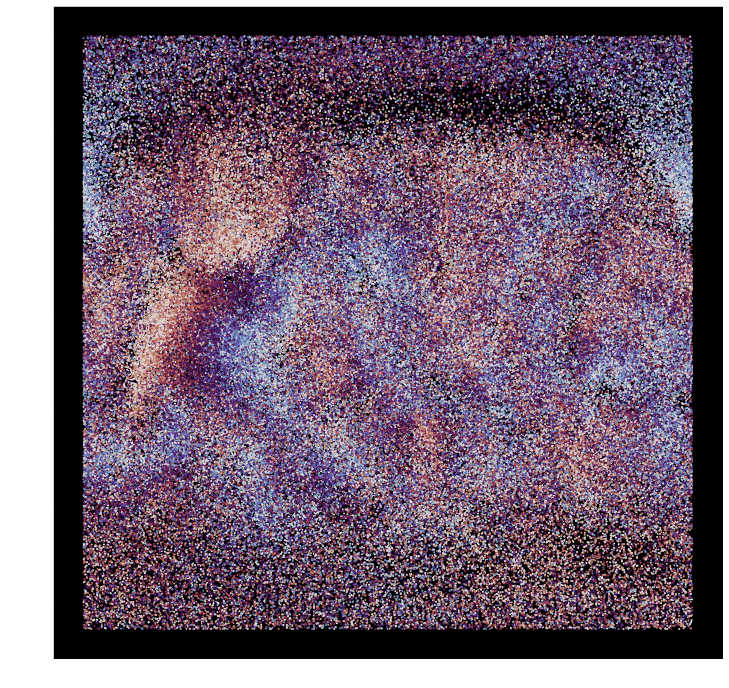

In [221]:
fig = plt.figure(figsize=(12,12))
plt.scatter(x, y, c=angle_test[test_slice2], cmap='twilight',s=1)

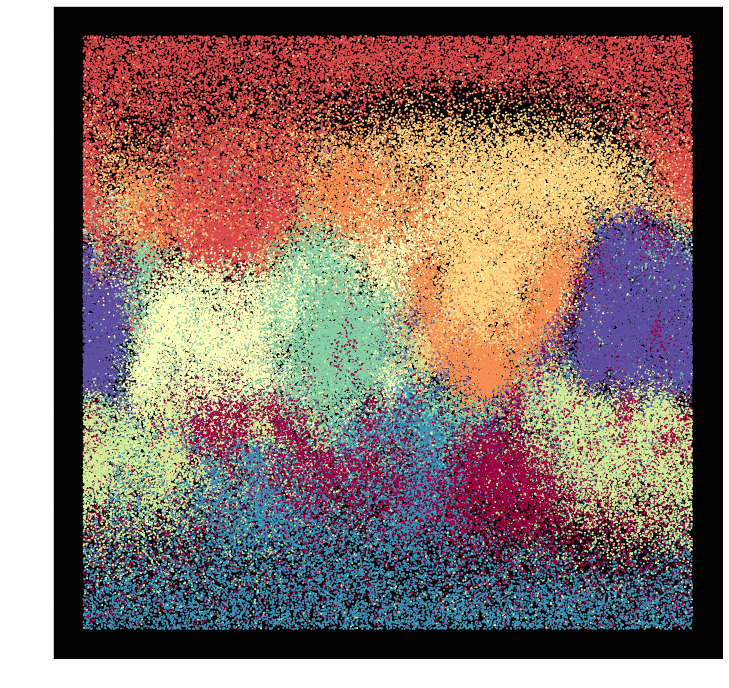

In [228]:
fig = plt.figure(figsize=(12,12))
plt.scatter(x, y, c=Y_angles[test_slice2], cmap='Spectral',s=1)

In [223]:
reducer_angle7 = umap.UMAP(output_metric='haversine',random_state=42).fit(X_train_log_angles3)

In [224]:
x = np.sin(reducer_angle7.embedding_[:, 0]) * np.cos(reducer_angle7.embedding_[:, 1])
y = np.sin(reducer_angle7.embedding_[:, 0]) * np.sin(reducer_angle7.embedding_[:, 1])
z = np.cos(reducer_angle7.embedding_[:, 0])
x = np.arctan2(x, y)
y = -np.arccos(z)

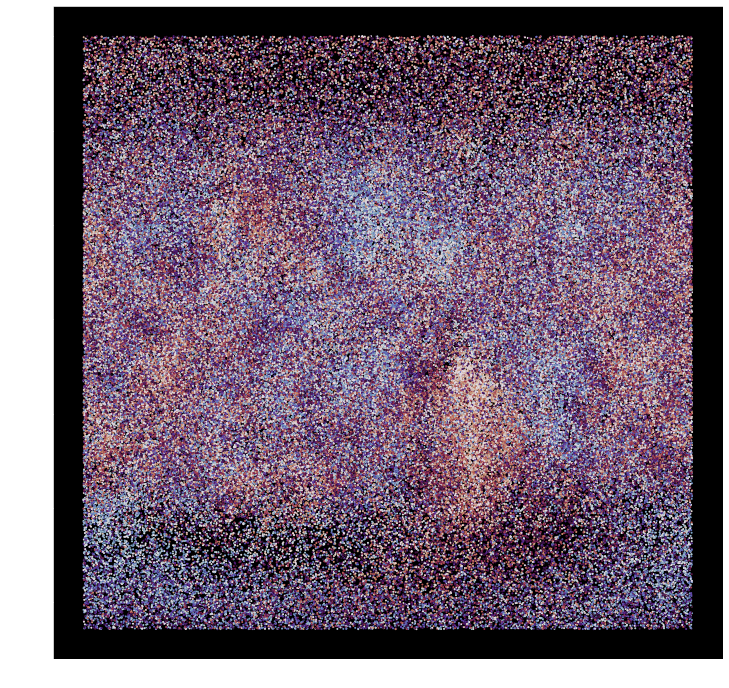

In [225]:
fig = plt.figure(figsize=(12,12))
plt.scatter(x, y, c=angle_test[test_slice2], cmap='twilight',s=1)

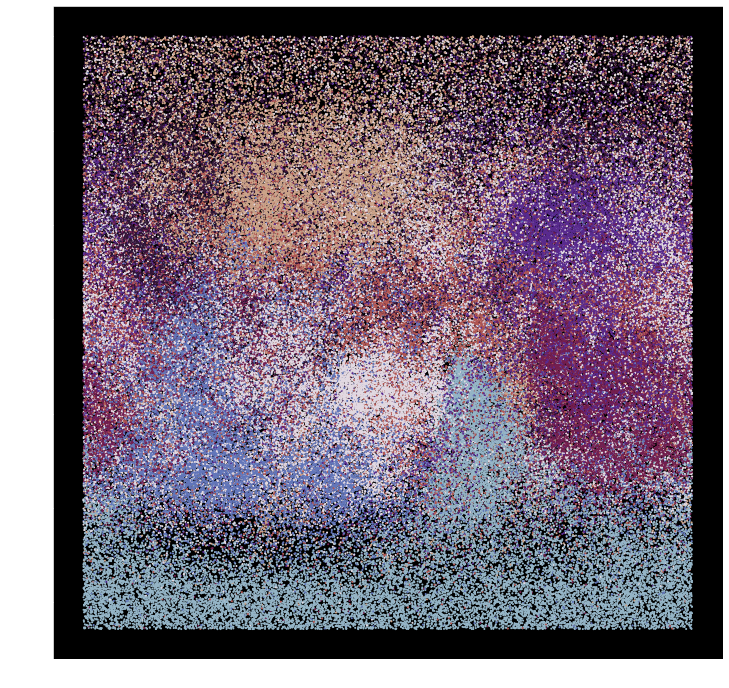

In [226]:
fig = plt.figure(figsize=(12,12))
plt.scatter(x, y, c=Y_angles[test_slice2], cmap='twilight',s=1)

Start on WISE

In [71]:
WISE_small = hd5_open('../../DHC/from_cannon/2021_02_05/WISE_DHC_a.h5','main/coeff')

In [72]:
sc=StandardScaler()
WISE_logX = sc.fit_transform(np.log10(WISE_small))

In [73]:
wise_mapper = umap.UMAP(n_neighbors = 15, random_state=42)
wise_mapper.fit(WISE_logX)

UMAP(dens_frac=0.0, dens_lambda=0.0, random_state=42)

In [75]:
WISE_small_labels = hd5_open('../../DHC/from_cannon/2021_02_05/WISE_DHC_a.h5','main/labels')

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


<AxesSubplot:>

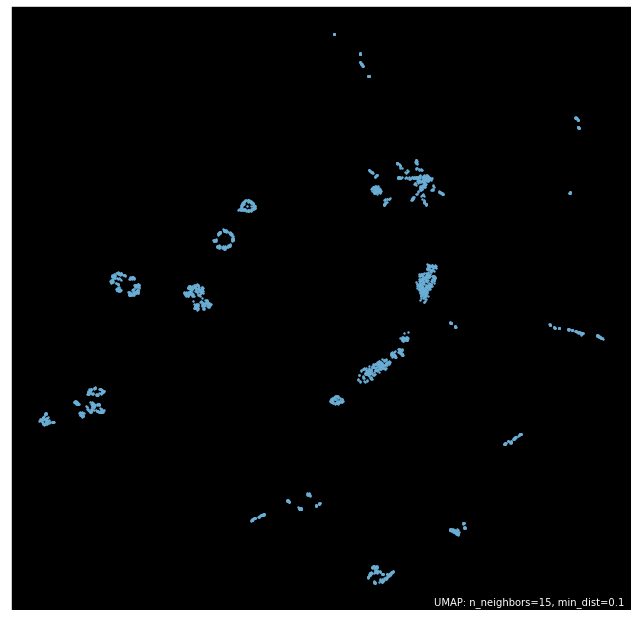

In [74]:
umap.plot.points(wise_mapper,background='black')

In [76]:
WISE_small_labels

array([[  0.,   0.,   0., ..., 276., 276., 276.],
       [  1.,   1.,   1., ...,  65., 193., 193.],
       [  1., 129., 257., ..., 193.,  65., 193.]])

In [129]:
hover_data = pd.DataFrame(WISE_small_labels.T)

In [130]:
hover_data

,0,1,2
0,0.0,1.0,1.0
1,0.0,1.0,129.0
2,0.0,1.0,257.0
3,0.0,129.0,1.0
4,0.0,129.0,129.0
...,...,...,...
3596,276.0,257.0,257.0
3597,276.0,65.0,65.0
3598,276.0,65.0,193.0
3599,276.0,193.0,65.0


In [148]:
WISE_small.shape

(2452, 3601)

In [134]:
df = hover_data.rename(columns={0: "File", 1:"spx", 2:"spy"})

In [135]:
df2 = df.astype(int)

In [115]:
from bokeh.plotting import figure, show, output_notebook
from bokeh.models import HoverTool, ColumnDataSource, CategoricalColorMapper
from bokeh.palettes import Spectral10

output_notebook()

Loading BokehJS ...

In [116]:
curdoc().theme = 'dark_minimal'

In [133]:
p = umap.plot.interactive(wise_mapper, hover_data=df, point_size=2,background='black')
umap.plot.show(p)

In [136]:
from bokeh.plotting import ColumnDataSource, figure, output_file, show

In [141]:
embedding_WMAP = wise_mapper.embedding_

In [143]:
WMAP_df = pd.DataFrame(embedding_WMAP, columns=('x', 'y'))

In [147]:
embedding_WMAP.shape

(2452, 2)

In [145]:
WISE_small_labels = WISE_small_labels.astype(int)

In [146]:
WMAP_df['File'] = WISE_small_labels[0,:]
WMAP_df['spx'] = WISE_small_labels[1,:]
WMAP_df['spy'] = WISE_small_labels[2,:]

ValueError: Length of values (3601) does not match length of index (2452)

In [139]:
source = ColumnDataSource(df2)

TOOLTIPS = [
    ("Index", "$index"),
    ("File", "@File"),
    ("spx", "@desc"),
    ("spy", "@desc"),
]

p = figure(plot_width=400, plot_height=400, tooltips=TOOLTIPS,
           title="DF-WSSA Set")

p.circle(
    'x',
    'y',
    source=source,
    line_alpha=0.6,
    fill_alpha=0.6,
    size=4
)

show(p)

bokeh.core.validation.check - ERROR - E-1001 (BAD_COLUMN_NAME): Glyph refers to nonexistent column name. This could either be due to a misspelling or typo, or due to an expected column being missing. : key "x" value "x", key "y" value "y" [renderer: GlyphRenderer(id=2634, glyph=Circle(id='2632', ...), ...)]


In [27]:
WISE_small = hd5_open('../../DHC/from_cannon/2021_02_05/WISE_DHC_a.h5','main/coeff')
WISE_small = WISE_small.T

In [28]:
WISE_small.shape

(3601, 2452)

In [152]:
sc=StandardScaler()
WISE_logX = sc.fit_transform(np.log10(WISE_small))

In [153]:
wise_mapper = umap.UMAP(n_neighbors = 15, random_state=42)
wise_mapper.fit(WISE_logX)

UMAP(dens_frac=0.0, dens_lambda=0.0, random_state=42)

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


<AxesSubplot:>

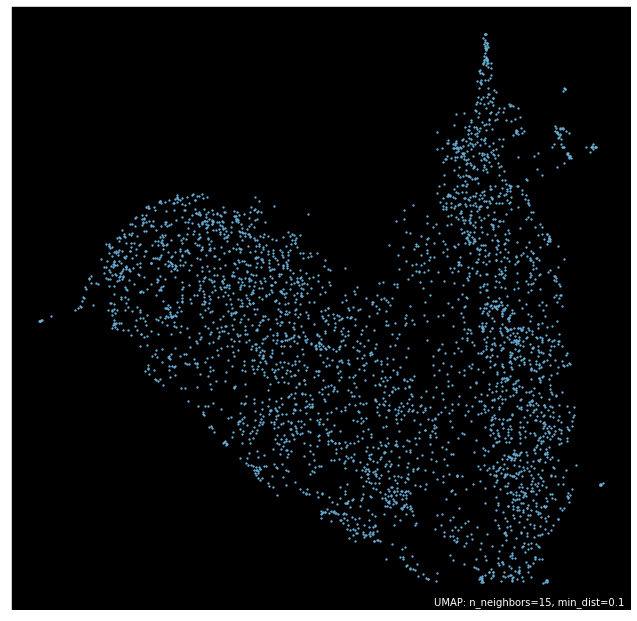

In [154]:
umap.plot.points(wise_mapper,background='black')

In [155]:
embedding_WMAP = wise_mapper.embedding_

In [158]:
WISE_small_labels = hd5_open('../../DHC/from_cannon/2021_02_05/WISE_DHC_a.h5','main/labels')
WISE_small_labels = WISE_small_labels.astype(int).T

In [161]:
WMAP_df = pd.DataFrame(embedding_WMAP, columns=('x', 'y'))
WMAP_df['File'] = WISE_small_labels[:,0]
WMAP_df['spx'] = WISE_small_labels[:,1]
WMAP_df['spy'] = WISE_small_labels[:,2]

In [170]:
from bokeh.models import LinearColorMapper, BasicTicker, ColorBar

In [176]:
p = umap.plot.interactive(wise_mapper, labels=WISE_small_labels[:,0], hover_data=WMAP_df, point_size=2,background='black')
#color_mapper = LinearColorMapper(palette="Spectral", low=0, high=277)
#color_bar = ColorBar(color_mapper=color_mapper, ticker= BasicTicker(),location=(0,0))

#p.add_layout(color_bar, 'right')
umap.plot.show(p)

In [177]:
WISE_small_labels_na = hd5_open('../../DHC/from_cannon/2021_02_05/WISE_DHC.h5','main/labels')
WISE_small_labels_na = WISE_small_labels_na.astype(int).T
WISE_small_na = hd5_open('../../DHC/from_cannon/2021_02_05/WISE_DHC.h5','main/coeff')
WISE_small_na = WISE_small_na.T

In [178]:
sc=StandardScaler()
WISE_logX_na = sc.fit_transform(np.log10(WISE_small_na))

In [179]:
wise_mapper_na = umap.UMAP(n_neighbors = 15, random_state=42)
wise_mapper_na.fit(WISE_logX_na)

UMAP(dens_frac=0.0, dens_lambda=0.0, random_state=42)

In [180]:
embedding_WMAP_na = wise_mapper_na.embedding_
WMAP_df_na = pd.DataFrame(embedding_WMAP_na, columns=('x', 'y'))
WMAP_df_na['File'] = WISE_small_labels_na[:,0]
WMAP_df_na['spx'] = WISE_small_labels_na[:,1]
WMAP_df_na['spy'] = WISE_small_labels_na[:,2]

In [181]:
p = umap.plot.interactive(wise_mapper_na, labels=WISE_small_labels_na[:,0], hover_data=WMAP_df_na, point_size=2,background='black')
#color_mapper = LinearColorMapper(palette="Spectral", low=0, high=277)
#color_bar = ColorBar(color_mapper=color_mapper, ticker= BasicTicker(),location=(0,0))

#p.add_layout(color_bar, 'right')
umap.plot.show(p)

In [185]:
WISE_small_na_iso = DHC_iso_vec(WISE_small_na,6,8)

In [188]:
sc=StandardScaler()
WISE_logX_na_iso = sc.fit_transform(np.log10(WISE_small_na_iso))

In [189]:
wise_mapper_na_iso = umap.UMAP(n_neighbors = 15, random_state=42)
wise_mapper_na_iso.fit(WISE_logX_na_iso)

UMAP(dens_frac=0.0, dens_lambda=0.0, random_state=42)

In [198]:
embedding_WMAP_na_iso = wise_mapper_na_iso.embedding_
WMAP_df_na_iso = pd.DataFrame(embedding_WMAP_na_iso, columns=('x', 'y'))
WMAP_df_na_iso['File'] = WISE_small_labels_na[:,0]
WMAP_df_na_iso['spx'] = WISE_small_labels_na[:,1]
WMAP_df_na_iso['spy'] = WISE_small_labels_na[:,2]

In [199]:
p = umap.plot.interactive(wise_mapper_na_iso, labels=WISE_small_labels_na[:,0], hover_data=WMAP_df_na_iso, point_size=2,background='black')
umap.plot.show(p)

In [29]:
WISE_small_iso = DHC_iso_vec(WISE_small,6,8)

In [30]:
sc=StandardScaler()
WISE_logX_iso = sc.fit_transform(np.log10(WISE_small_iso))

In [193]:
wise_mapper_iso = umap.UMAP(n_neighbors = 15, random_state=42)
wise_mapper_iso.fit(WISE_logX_iso)

UMAP(dens_frac=0.0, dens_lambda=0.0, random_state=42)

In [200]:
embedding_WMAP_iso = wise_mapper_iso.embedding_
WMAP_df_iso = pd.DataFrame(embedding_WMAP_iso, columns=('x', 'y'))
WMAP_df_iso['File'] = WISE_small_labels[:,0]
WMAP_df_iso['spx'] = WISE_small_labels[:,1]
WMAP_df_iso['spy'] = WISE_small_labels[:,2]

In [201]:
p = umap.plot.interactive(wise_mapper_iso, labels=WISE_small_labels[:,0], hover_data=WMAP_df, point_size=2,background='black')
umap.plot.show(p)

In [6]:
WISE_big_labels= hd5_open('../../DHC/from_cannon/2021_02_05/WISE_DHC_unclean_a.h5','main/labels')
WISE_big_labels = WISE_big_labels.astype(int).T
WISE_big = hd5_open('../../DHC/from_cannon/2021_02_05/WISE_DHC_unclean_a.h5','main/coeff')
WISE_big = WISE_big.T

In [7]:
WISE_big_iso = DHC_iso_vec(WISE_big,6,8)

In [8]:
sc=StandardScaler()
WISE_big_logX_iso = sc.fit_transform(np.arcsinh(WISE_big_iso/(1e-20)))

In [9]:
WISE_big_logX_iso.shape

(800230, 310)

In [10]:
import pickle

In [12]:
import numba

In [13]:
numba.config.NUMBA_DEFAULT_NUM_THREADS

16

In [21]:
numba.config.NUMBA_NUM_THREADS = 16
numba.config.NUMBA_DEFAULT_NUM_THREADS = 16

In [22]:
wise_mapper_big_iso = umap.UMAP(n_neighbors = 15, random_state=42)
wise_mapper_big_iso.fit(WISE_big_logX_iso)

UMAP(dens_frac=0.0, dens_lambda=0.0, random_state=42)

In [23]:
pickle.dump(wise_mapper_big_iso, open("wise_mapper_big_iso.p", "wb"))

In [32]:
wise_mapper_big_iso = pickle.load( open( "wise_mapper_big_iso.p", "rb" ) )

In [24]:
embedding_WMAP_big_iso = wise_mapper_big_iso.embedding_
WMAP_df_big_iso = pd.DataFrame(embedding_WMAP_big_iso, columns=('x', 'y'))
WMAP_df_big_iso['File'] = WISE_big_labels[:,0]
WMAP_df_big_iso['spx'] = WISE_big_labels[:,1]
WMAP_df_big_iso['spy'] = WISE_big_labels[:,2]

<AxesSubplot:>

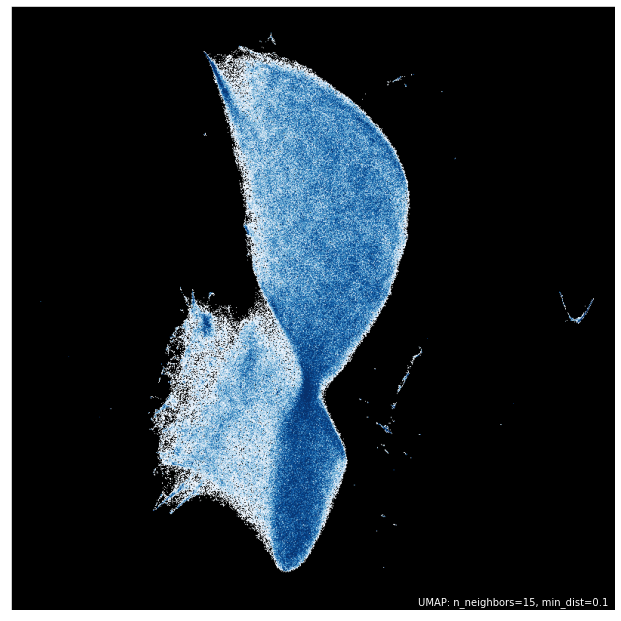

In [25]:
umap.plot.points(wise_mapper_big_iso,background='black')

In [33]:
emb_test = wise_mapper_big_iso.transform(WISE_logX_iso)

inside function
   (0, 19045)	0.27464762
  (0, 148137)	0.27893138
  (0, 203420)	0.29946613
  (0, 249158)	0.27263892
  (0, 268791)	0.28456688
  (0, 274248)	0.2770228
  (0, 345056)	0.27478403
  (0, 409808)	0.28927988
  (0, 437972)	0.27236623
  (0, 450245)	0.2737163
  (0, 564462)	0.27224272
  (0, 571006)	0.29075015
  (0, 697060)	0.27260193
  (0, 732849)	0.2738838
  (0, 732885)	0.31348312
  (1, 54348)	0.29390135
  (1, 114623)	0.27330887
  (1, 138923)	0.2772609
  (1, 146349)	0.2774085
  (1, 166362)	0.28307918
  (1, 263017)	0.2852684
  (1, 270227)	0.2753175
  (1, 311570)	0.2770622
  (1, 334332)	0.2807464
  (1, 382357)	0.27987024
  :	:
  (3599, 546076)	0.28659856
  (3599, 562303)	0.2776149
  (3599, 564652)	0.27876484
  (3599, 585092)	0.2789996
  (3599, 712108)	0.2745671
  (3599, 733771)	0.2809279
  (3599, 748516)	0.28242418
  (3599, 749203)	0.2858074
  (3599, 775319)	0.27199757
  (3599, 788166)	0.285801
  (3600, 41112)	0.27760255
  (3600, 47755)	0.27459595
  (3600, 73657)	0.27932796
  (3600, 

In [34]:
import datashader as ds, pandas as pd, colorcet as cc

In [46]:
embed_df = pd.DataFrame(data=emb_test,columns=["x", "y"])

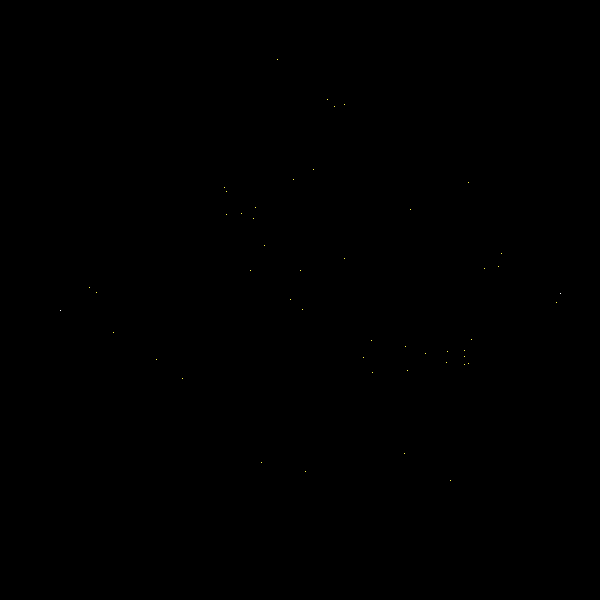

In [48]:
agg1 = ds.Canvas().points(embed_df,'x','y')
ds.tf.set_background(ds.tf.shade(agg1, cmap=cc.fire), "black")

In [44]:
embed_bigiso = wise_mapper_big_iso.embedding_
embed_df_big = pd.DataFrame(data=embed_bigiso,columns=["x", "y"])

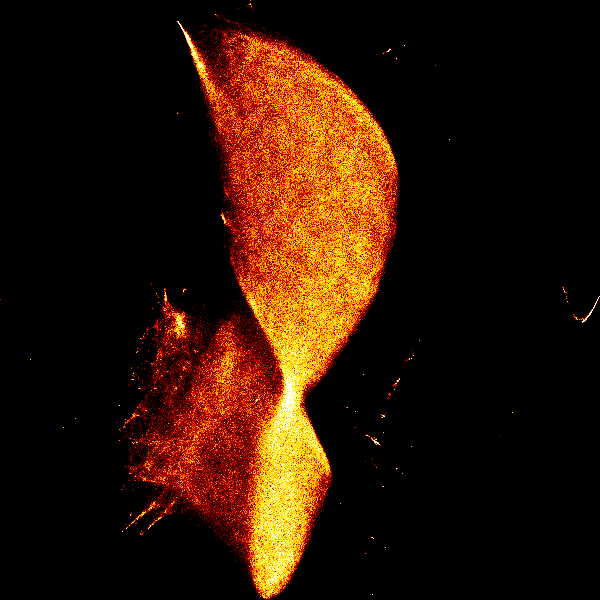

In [52]:
agg = ds.Canvas().points(embed_df_big,'x','y')
ds.tf.set_background(ds.tf.shade(agg, cmap=cc.fire), "black")
#ds.tf.set_background(ds.tf.shade(agg1, cmap=cc.fire), "black")

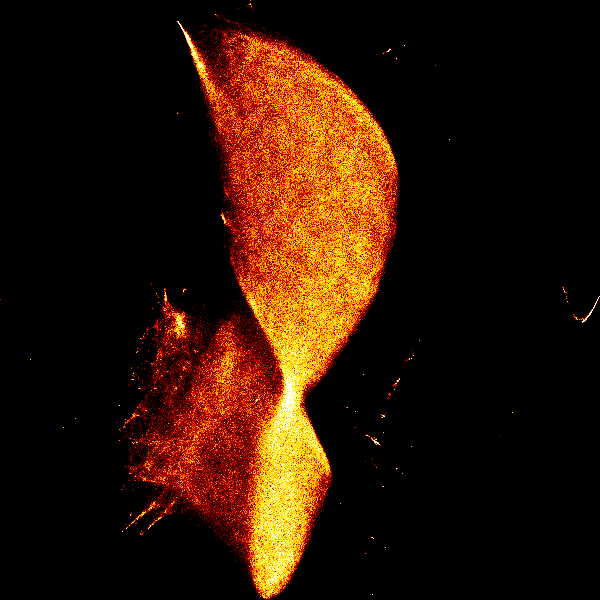

In [70]:
import datashader.transfer_functions as tf

p= tf.shade(ds.Canvas().points(embed_df_big,'x','y'),cmap=cc.fire)
tf.set_background(p,"black")

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
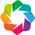

In [63]:
import holoviews as hv
from holoviews.operation.datashader import datashade
hv.extension("bokeh")
from bokeh.io import curdoc
curdoc().theme = 'dark_minimal'
from bokeh.plotting import figure, output_file, show

In [67]:
p = datashade(hv.Points(embed_df_big),cmap=cc.fire, width=600, height=600)

TypeError: Expected `Image`, got: `<class 'holoviews.core.spaces.DynamicMap'>`

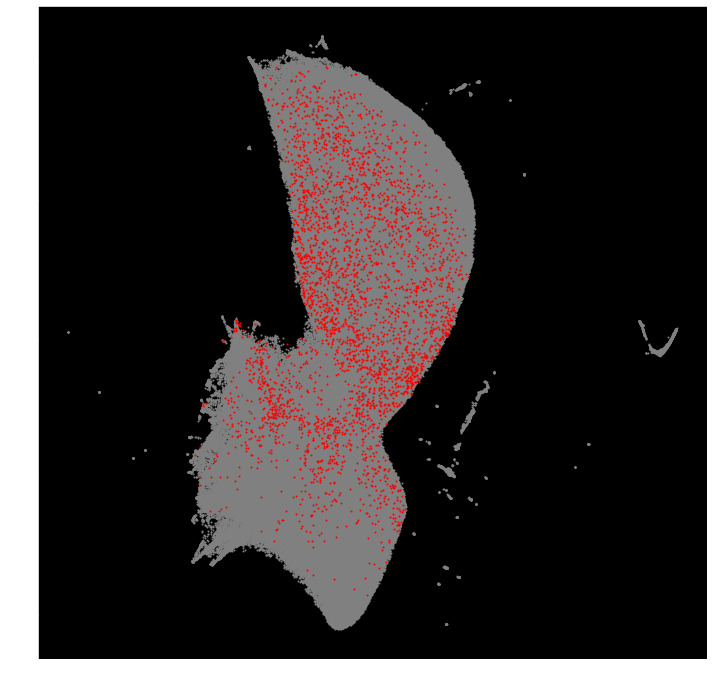

In [74]:
fig = plt.figure(figsize=(12,12))
plt.scatter(embed_bigiso[:,0],embed_bigiso[:,1], c='grey',s=1)
plt.scatter(emb_test[:,0],emb_test[:,1], c='red',s=1)

In [73]:
emb_test.shape

(3601, 2)